In [1]:
# update the git
! git add  .
! git commit -m "From Mac"
! git push

[master 9b27c2ea] From Mac
 4 files changed, 4470 insertions(+), 6556 deletions(-)
 rewrite NeuralNetwork/AAE/.ipynb_checkpoints/5. add discrim . ipynb-checkpoint.ipynb (99%)
 copy NeuralNetwork/AAE/.ipynb_checkpoints/{5. add discrim . ipynb-checkpoint.ipynb => 6 no norm -checkpoint.ipynb} (73%)
 create mode 100644 NeuralNetwork/AAE/6 no norm .ipynb
Counting objects: 14, done.
Delta compression using up to 4 threads.
Compressing objects: 100% (14/14), done.
Writing objects: 100% (14/14), 50.54 MiB | 3.22 MiB/s, done.
Total 14 (delta 9), reused 0 (delta 0)
remote: Resolving deltas: 100% (9/9), completed with 4 local objects.
To https://github.com/JaeDukSeo/Daily-Neural-Network-Practice-2
   1cdd66c1..9b27c2ea  master -> master


In [2]:
# import library
import matplotlib 
matplotlib.use('Agg')
%matplotlib inline
import numpy as np
import sys, os,cv2
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
from sklearn.preprocessing import OneHotEncoder
from skimage.transform import resize
from scipy.misc import imread
from imgaug import augmenters as iaa
import nibabel as nib
import imgaug as ia
from scipy.ndimage import zoom
from sklearn.utils import shuffle
import matplotlib.animation as animation

# Generate training data
import tensorflow as tf
old_v = tf.logging.get_verbosity()
tf.logging.set_verbosity(tf.logging.ERROR)
from tensorflow.examples.tutorials.mnist import input_data

plt.style.use('seaborn-white')
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
np.random.seed(6278)
tf.set_random_seed(6728)
ia.seed(6278)

In [3]:
# get the mnist data set
mnist = input_data.read_data_sets('../../Dataset/MNIST/', one_hot=True)
x_data, train_label, y_data, test_label = mnist.train.images, mnist.train.labels, mnist.test.images, mnist.test.labels
x_data_added,x_data_added_label = mnist.validation.images,mnist.validation.labels
x_data = x_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
y_data = y_data.reshape(-1, 28, 28, 1)  # 28x28x1 input img
x_data_added = x_data_added.reshape(-1, 28, 28, 1)
x_data = np.vstack((x_data,x_data_added))
train_label = np.vstack((train_label,x_data_added_label))

train_batch = np.zeros((20000,28,28,1))
test_batch = np.zeros((10000,28,28,1))
for iter in range(20000):
    train_batch[iter,:,:,:] = np.expand_dims(resize(x_data[iter,:,:,0],(28,28)),axis=3)

# print out the data shape and the max and min value
print(train_batch.shape)
print(train_batch.max())
print(train_batch.min())
print(train_label.shape)
print(train_label.max())
print(train_label.min())
print(test_batch.shape)
print(test_batch.max())
print(test_batch.min())
print(test_label.shape)
print(test_label.max())
print(test_label.min())

Extracting ../../Dataset/MNIST/train-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/train-labels-idx1-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-images-idx3-ubyte.gz
Extracting ../../Dataset/MNIST/t10k-labels-idx1-ubyte.gz


/anaconda3/lib/python3.6/site-packages/skimage/transform/_warps.py:84: UserWarning: The default mode, 'constant', will be changed to 'reflect' in skimage 0.15.
  warn("The default mode, 'constant', will be changed to 'reflect' in "
/anaconda3/lib/python3.6/site-packages/ipykernel_launcher.py:14: DeprecationWarning: Both axis > a.ndim and axis < -a.ndim - 1 are deprecated and will raise an AxisError in the future.
  


(20000, 28, 28, 1)
1.0
0.0
(60000, 10)
1.0
0.0
(10000, 28, 28, 1)
0.0
0.0
(10000, 10)
1.0
0.0


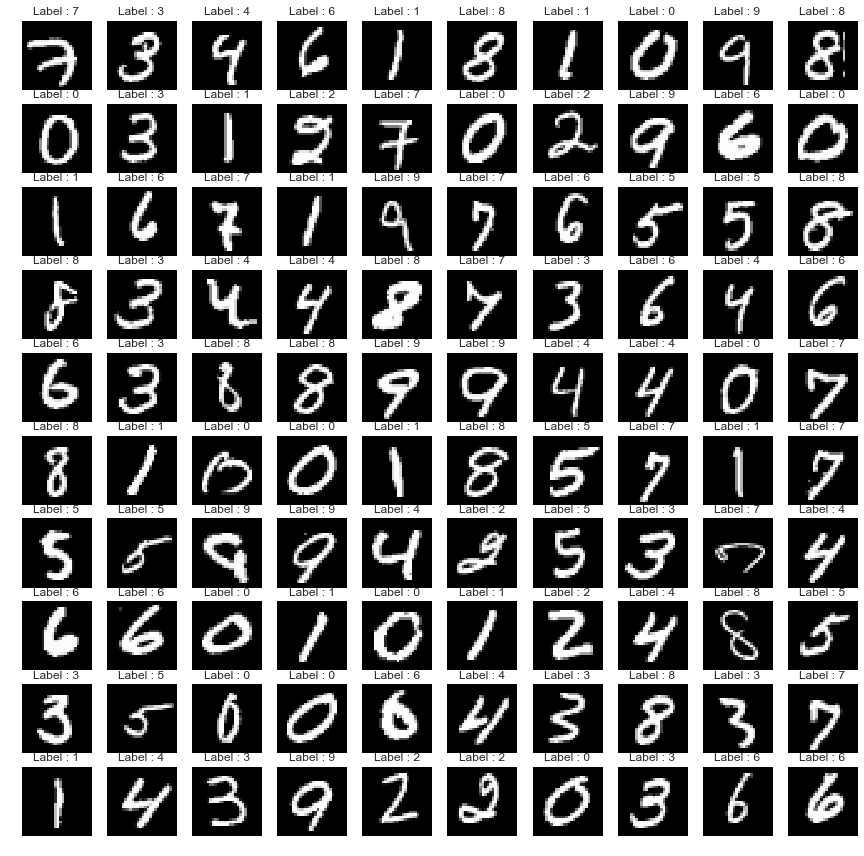

In [4]:
# show small amount of data
fig=plt.figure(figsize=(15, 15))
columns = 10 ; rows = 10
for i in range(1, columns*rows +1):
    fig.add_subplot(rows, columns, i)
    plt.imshow(np.squeeze(train_batch[i-1]),cmap='gray')
    plt.axis('off')
    plt.title("Label : "+str(np.argmax(train_label[i-1])))
plt.show()

In [5]:
# import all of the layers
def tf_elu(x):
    """ Exponential Linear Unit based on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : float
        The floating point number that is going to be applied to the ELU activation.

    Returns
    -------
    float
        Data with the same dimensions as the input after ELU

    """
    return tf.nn.elu(x)
def d_tf_elu(x):
    """Derivative of the Exponential Linear Unit base on the ICCV 2015 paper
    https://arxiv.org/pdf/1511.07289.pdf

    Parameters
    ----------
    x : type
        Description of parameter `x`.

    Returns
    -------
    type
        Description of returned object.

    """

    return tf.cast(tf.greater(x,0),tf.float32)  + (tf_elu(tf.cast(tf.less_equal(x,0),tf.float32) * x) + 1.0)

def tf_identiy(x)  : return x
def d_tf_identiy(x): return tf.ones_like(x,dtype=tf.float32)

def tf_relu(x):   return tf.nn.relu(x)
def d_tf_relu(x): return tf.cast(tf.greater(x,0.0),tf.float32)

def tf_lrelu(x): return tf.nn.leaky_relu(x,alpha=0.2)
def d_tf_lrelu(x): return tf.cast(tf.greater(x,0),tf.float32) + tf.cast(tf.less_equal(x,0),tf.float32) * 0.2

def tf_tanh(x): return tf.nn.tanh(x)
def d_tf_tanh(x): return 1 - tf_tanh(x) ** 2

def tf_sigmoid(x):   return tf.nn.sigmoid(x)
def d_tf_sigmoid(x): return tf_sigmoid(x) * (1.0-tf_sigmoid(x))

def tf_atan(x): return tf.atan(x)
def d_tf_atan(x): return 1.0/(1.0 + x**2)

def tf_softmax(x): return tf.nn.softmax(x)
def softabs(x): return tf.sqrt(x ** 2 + 1e-20)

def tf_logcosh(x): return tf.log(tf.cosh(x))
def d_tf_logcosh(x): return tf.tanh(x)

class FNN():

    def __init__(self,inc,outc,stddev=None,act=tf_elu,d_act=d_tf_elu,which_reg=0,init_x=False):
        if init_x:
            interval = np.sqrt(6.0 / (inc + outc + 1.0))
            self.w = tf.Variable(tf.random_uniform(shape=(inc, outc),minval=-interval,maxval=interval,dtype=tf.float32,seed=2))
            self.b = tf.Variable(tf.zeros(shape=[outc],dtype=tf.float32))
        else:
            self.w = tf.Variable(tf.random_normal([inc,outc],stddev=stddev,seed=2,dtype=tf.float32))
            self.b = tf.Variable(tf.zeros([outc],dtype=tf.float32))

        self.m,  self.v   = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.m_b,self.v_b = tf.Variable(tf.zeros_like(self.b)),tf.Variable(tf.zeros_like(self.b))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg

    def getw(self): return self.w

    def feedforward(self,input=None):
        self.input  = input
        self.layer  = tf.matmul(input,self.w) + self.b
        self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient=None,learning_rate=None):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2
        grad  = tf.matmul(tf.transpose(grad_part_3),grad_middle)/batch_size
        grad_b= tf.reduce_mean(grad_middle,0)/batch_size
        grad_pass = tf.matmul(grad_middle,tf.transpose(self.w))

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1.-beta1)
        v_hat = self.v / (1.-beta2)
        adam_middle  = m_hat     *  learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,adam_middle )))

        update_w.append(tf.assign(self.m_b,self.m_b*beta1 + (1-beta1) * (grad_b)   ))
        update_w.append(tf.assign(self.v_b,self.v_b*beta2 + (1-beta2) * (grad_b ** 2)   ))
        m_hat_b = self.m_b / (1-beta1)
        v_hat_b = self.v_b / (1-beta2)
        adam_middle_b = m_hat_b *  learning_rate/(tf.sqrt(v_hat_b) + adam_e)
        update_w.append(tf.assign(self.b,tf.subtract(self.b,adam_middle_b ))) 
        
        return grad_pass,update_w

class CNN():

    def __init__(self,k,inc,out,stddev=0.005,which_reg=0,act=tf_elu,d_act=d_tf_elu,residual=False):
        self.w = tf.Variable(tf.random_normal([k,k,inc,out],stddev=stddev,seed=2,dtype=tf.float32))
        self.m,self.v = tf.Variable(tf.zeros_like(self.w)),tf.Variable(tf.zeros_like(self.w))
        self.act,self.d_act = act,d_act
        self.which_reg = which_reg
        self.residual = residual

    def getw(self): return self.w

    def feedforward(self,input,stride=1,padding='VALID'):
        self.input  = input
        if self.residual: 
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding='SAME')
            self.layerA = self.act(self.layer) + input
        else:
            self.layer  = tf.nn.conv2d(input,self.w,strides=[1,stride,stride,1],padding=padding)
            self.layerA = self.act(self.layer)
        return self.layerA

    def backprop(self,gradient,stride=1,padding='VALID'):
        grad_part_1 = gradient
        grad_part_2 = self.d_act(self.layer)
        grad_part_3 = self.input

        grad_middle = grad_part_1 * grad_part_2

        if self.residual: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) / batch_size
            
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding='SAME'
            ) + gradient
        else: 
            grad = tf.nn.conv2d_backprop_filter(input = grad_part_3,filter_sizes = self.w.shape,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            ) / batch_size
        
            grad_pass = tf.nn.conv2d_backprop_input(input_sizes = [batch_size] + list(grad_part_3.shape[1:]),filter= self.w,out_backprop = grad_middle,
                strides=[1,stride,stride,1],padding=padding
            )

        # === Reg ===        
        if self.which_reg == 0:
            grad = grad

        if self.which_reg == 0.5:
            grad = grad + lamda * (tf.sqrt(tf.abs(self.w))) * (1.0/tf.sqrt(tf.abs(self.w)+ 10e-5)) * tf.sign(self.w)

        if self.which_reg == 1:
            grad = grad + lamda * tf.sign(self.w)

        if self.which_reg == 1.5:
            grad = grad + lamda * 1.0/(tf.sqrt(tf.square(self.w) + 10e-5)) * self.w

        if self.which_reg == 2:
            grad = grad + lamda * (1.0/tf.sqrt(tf.square(tf.abs(self.w))+ 10e-5)) * tf.abs(self.w) * tf.sign(self.w)

        if self.which_reg == 2.5:
            grad = grad + lamda * 2.0 * self.w

        if self.which_reg == 3:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),3)+ 10e-5,-0.66) * tf.pow(tf.abs(self.w),2) * tf.sign(self.w)

        if self.which_reg == 4:
            grad = grad + lamda * tf.pow(tf.pow(tf.abs(self.w),4)+ 10e-5,-0.75) * tf.pow(tf.abs(self.w),3) * tf.sign(self.w)

        update_w = []
        update_w.append(tf.assign( self.m,self.m*beta1 + (1-beta1) * (grad)   ))
        update_w.append(tf.assign( self.v,self.v*beta2 + (1-beta2) * (grad ** 2)   ))
        m_hat = self.m / (1-beta1)
        v_hat = self.v / (1-beta2)
        adam_middel = learning_rate/(tf.sqrt(v_hat) + adam_e)
        update_w.append(tf.assign(self.w,tf.subtract(self.w,tf.multiply(adam_middel,m_hat)  )))
        return grad_pass,update_w

In [6]:
# hyper class
num_epoch = 101; batch_size = 100; print_size = 1; lamda = 0.0
beta1,beta2,adam_e = 0.9,0.999,1e-8; eps = 1e-10

e1 = FNN(784,1000,       stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
e3 = FNN(1000,2,         stddev=0.005,which_reg=0,act=tf_identiy,d_act=d_tf_identiy)

d1 = FNN(2,1000,         stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d2 = FNN(1000,1000,      stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
d3 = FNN(1000,784,       stddev=0.005,which_reg=0,act=tf_sigmoid,d_act=d_tf_sigmoid)

discrim1 = FNN(2,1000   ,stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
discrim2 = FNN(1000,1000,stddev=0.005,which_reg=0,act=tf_relu,d_act=d_tf_relu)
discrim3 = FNN(1000,1   ,stddev=0.005,which_reg=0,act=tf_sigmoid,d_act=d_tf_sigmoid)

def norm_vec(x):
    return ((x-tf.reduce_min(x,1)[:,None]) /(tf.reduce_max(x,1)-tf.reduce_min(x,1))[:,None]) *\
           (0.00005 + 0.00005) - 0.00005

In [7]:
# 0. Update the encoding and decoding
x0  = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr0 = tf.placeholder(shape=[],dtype=tf.float32)

elayer1 = e1.feedforward(x0)
elayer2 = e2.feedforward(elayer1)
elayer3 = e3.feedforward(elayer2)

dlayer1 = d1.feedforward(elayer3)
dlayer2 = d2.feedforward(dlayer1)
dlayer3 = d3.feedforward(dlayer2)

recon_cost = -tf.reduce_mean(x0*tf.log(dlayer3+10e-10)+ (1.0-x0)*tf.log(1.0-dlayer3+10e-10))
# auto_train = tf.train.AdamOptimizer(learning_rate=lr0).minimize(recon_cost)
recon_ = (-(x0/(dlayer3+10e-10)) + (1.0-x0)/(1.0-dlayer3+10e-10))/(batch_size)


dgrad3,dgrad3_up = d3.backprop(recon_,learning_rate=lr0)
dgrad2,dgrad2_up = d2.backprop(dgrad3,learning_rate=lr0)
dgrad1,dgrad1_up = d1.backprop(dgrad2,learning_rate=lr0)

egrad3,egrad3_up = e3.backprop(dgrad1,learning_rate=lr0)
egrad2,egrad2_up = e2.backprop(egrad3,learning_rate=lr0)
egrad1,egrad1_up = e1.backprop(egrad2,learning_rate=lr0)

grad0_update = dgrad3_up + dgrad2_up + dgrad1_up + egrad3_up + egrad2_up + egrad1_up

In [8]:
# 1. Update the discrimator (with encode)
x1       = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr1      = tf.placeholder(shape=[],dtype=tf.float32)
x1_label = tf.zeros((batch_size,1),dtype=tf.float32)

elayer1_dis = e1.feedforward(x1)
elayer2_dis = e2.feedforward(elayer1_dis)
elayer3_dis = e3.feedforward(elayer2_dis)

dislayer1_dis1= discrim1.feedforward(elayer3_dis)
dislayer2_dis1= discrim2.feedforward(dislayer1_dis1)
dislayer3_dis1= discrim3.feedforward(dislayer2_dis1)

dis_cost1 = - tf.reduce_mean(x1_label * tf.log(dislayer3_dis1 + 10e-10) + (1.-x1_label) * tf.log(1.-dislayer3_dis1+10e-10))
dis_grad1 = (-(x1_label/(dislayer3_dis1+10e-10)) + (1.0-x1_label)/(1.0-dislayer3_dis1+10e-10))/(batch_size)

disgrad31,disgrad31_up = discrim3.backprop(dis_grad1,learning_rate=lr1)
disgrad21,disgrad21_up = discrim2.backprop(disgrad31,learning_rate=lr1)
disgrad11,disgrad11_up = discrim1.backprop(disgrad21,learning_rate=lr1)

grad1_update = disgrad31_up + disgrad21_up + disgrad11_up

In [9]:
# 2. Update the discrimator (with prior)
x2       = tf.placeholder(shape=[batch_size,2],dtype=tf.float32)
lr2      = tf.placeholder(shape=[],dtype=tf.float32)
x2_label = tf.ones((batch_size,1),dtype=tf.float32)

dislayer1_dis2= discrim1.feedforward(x2)
dislayer2_dis2= discrim2.feedforward(dislayer1_dis2)
dislayer3_dis2= discrim3.feedforward(dislayer2_dis2)

dis_cost2 = - tf.reduce_mean(x2_label * tf.log(dislayer3_dis2 + 10e-10) + (1.-x2_label) * tf.log(1.-dislayer3_dis2+10e-10))
dis_grad2 = (-(x2_label/(dislayer3_dis2+10e-10)) + (1.0-x2_label)/(1.0-dislayer3_dis2+10e-10))/(batch_size)

disgrad32,disgrad32_up = discrim3.backprop(dis_grad2,learning_rate=lr2)
disgrad22,disgrad22_up = discrim2.backprop(disgrad32,learning_rate=lr2)
disgrad12,disgrad12_up = discrim1.backprop(disgrad22,learning_rate=lr2)

grad2_update = disgrad32_up + disgrad22_up + disgrad12_up

In [10]:
# 3. update the generator 
x3       = tf.placeholder(shape=[batch_size,784],dtype=tf.float32)
lr3      = tf.placeholder(shape=[],dtype=tf.float32)
x3_label = tf.ones((batch_size,1),dtype=tf.float32)

elayer13 = e1.feedforward(x3)
elayer23 = e2.feedforward(elayer13)
elayer33 = e3.feedforward(elayer23)

dlayer13 = discrim1.feedforward(elayer33)
dlayer23 = discrim2.feedforward(dlayer13)
dlayer33 = discrim3.feedforward(dlayer23)

fake_cost = - tf.reduce_mean(x3_label * tf.log(dlayer33 + 10e-10) + (1.-x3_label) * tf.log(1.-dlayer33+10e-10))
fake_grad = (-(x3_label/(dlayer33+10e-10)) + (1.0-x3_label)/(1.0-dlayer33+10e-10))/(batch_size)

fake_disgrad3,_ = discrim3.backprop(fake_grad,learning_rate=lr3)
fake_disgrad2,_ = discrim2.backprop(fake_disgrad3,learning_rate=lr3)
fake_disgrad1,_ = discrim1.backprop(fake_disgrad2,learning_rate=lr3)

fake_egrad3,fake_egrad3_up = e3.backprop(fake_disgrad1,learning_rate=lr3)
fake_egrad2,fake_egrad2_up = e2.backprop(fake_egrad3  ,learning_rate=lr3)
fake_egrad1,fake_egrad1_up = e1.backprop(fake_egrad2  ,learning_rate=lr3)

fake_grad_update = fake_egrad3_up + fake_egrad2_up + fake_egrad1_up

 iter: 0 batch: 19900 recon cost: 0.23115775 zero cost: 0.0028151774								 one  cost: 0.0020343615 fake cost: 15.7327579509

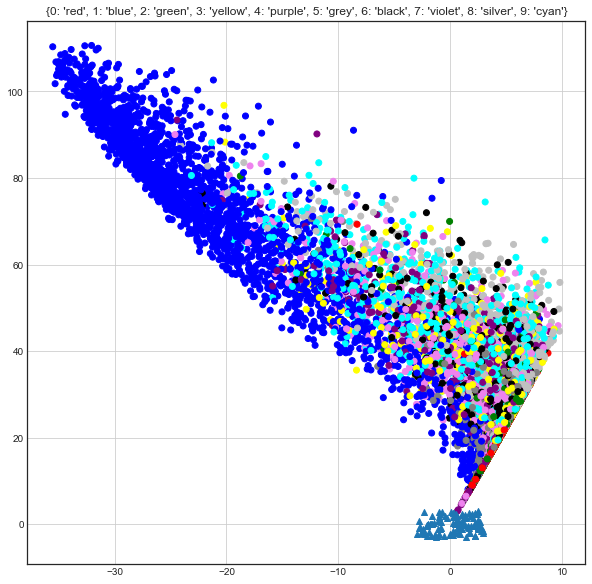

 iter: 1 batch: 19900 recon cost: 0.21175721 zero cost: 0.3521035								 one  cost: 0.41369453 fake cost: 5.759287545717

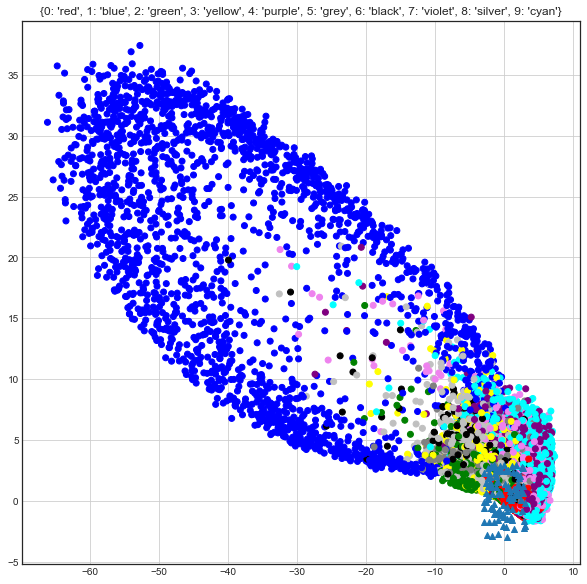

 iter: 2 batch: 19900 recon cost: 0.20511565 zero cost: 0.4382997								 one  cost: 0.52473974 fake cost: 3.44938857

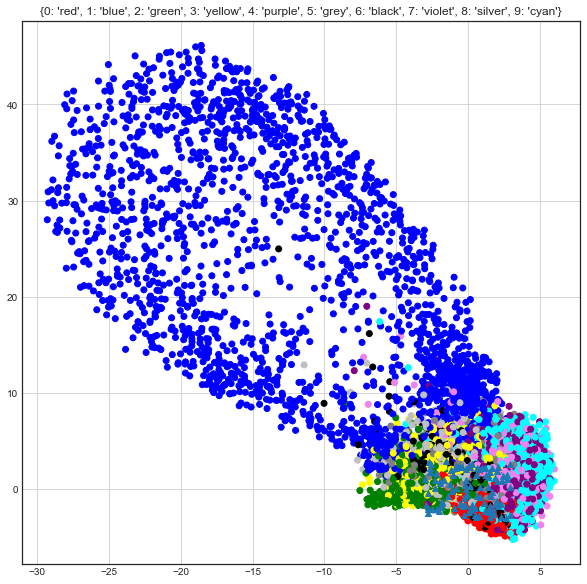

 iter: 3 batch: 19900 recon cost: 0.19552645 zero cost: 0.45317823								 one  cost: 0.54259557 fake cost: 3.0976477

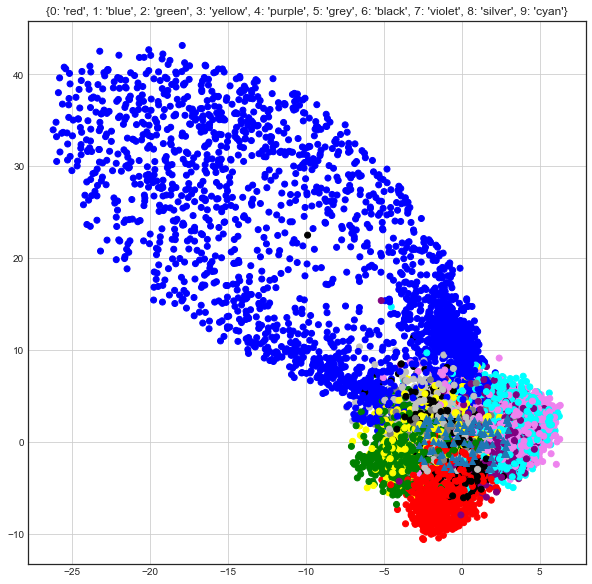

 iter: 4 batch: 19900 recon cost: 0.19141142 zero cost: 0.49268356								 one  cost: 0.56382424 fake cost: 2.8101637

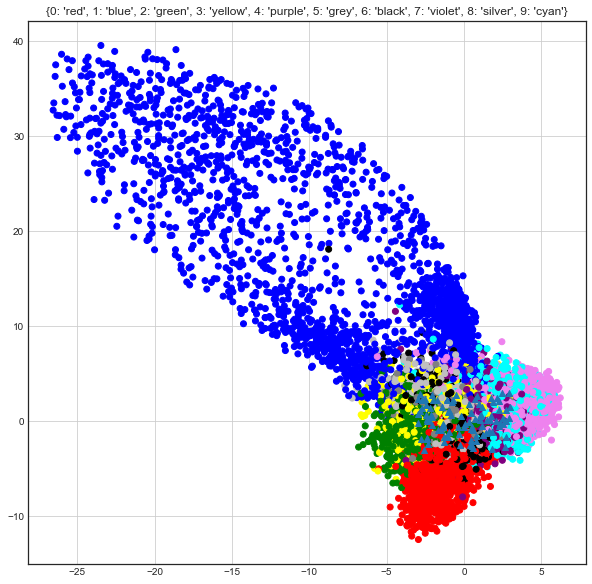

 iter: 5 batch: 19900 recon cost: 0.18900105 zero cost: 0.505106								 one  cost: 0.5360773 fake cost: 2.7993174085

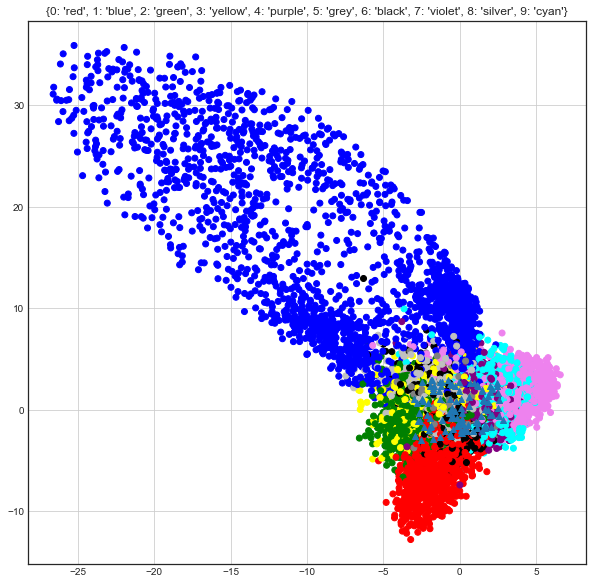

 iter: 6 batch: 19900 recon cost: 0.18728918 zero cost: 0.5277436								 one  cost: 0.52679074 fake cost: 2.64034917

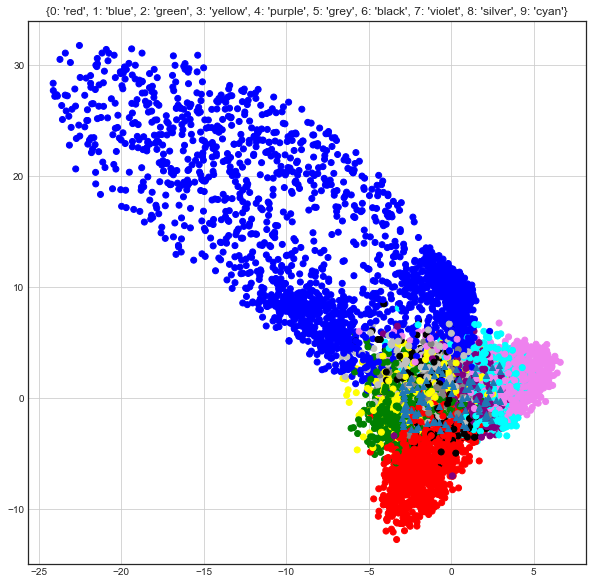

 iter: 7 batch: 19900 recon cost: 0.18627906 zero cost: 0.5761069								 one  cost: 0.56272763 fake cost: 2.44799883

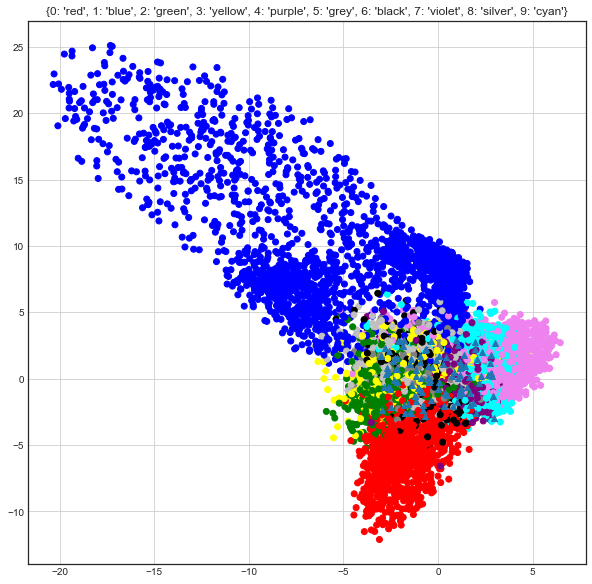

 iter: 8 batch: 19900 recon cost: 0.18557748 zero cost: 0.5872912								 one  cost: 0.46308106 fake cost: 2.04855352

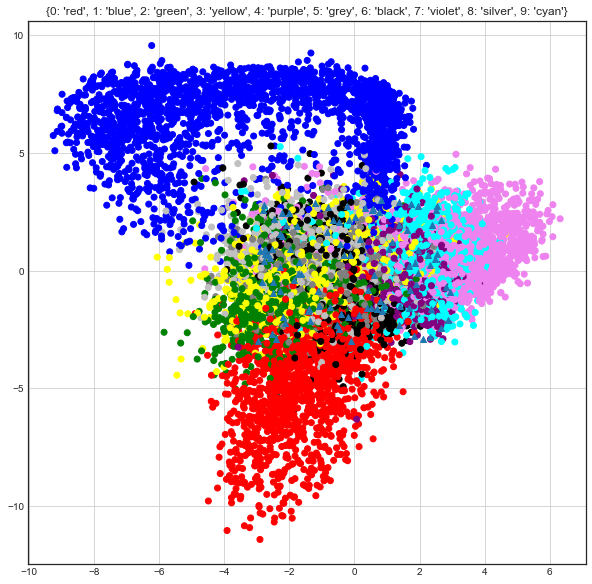

 iter: 9 batch: 19900 recon cost: 0.18491504 zero cost: 0.57698816								 one  cost: 0.5708082 fake cost: 1.99805127

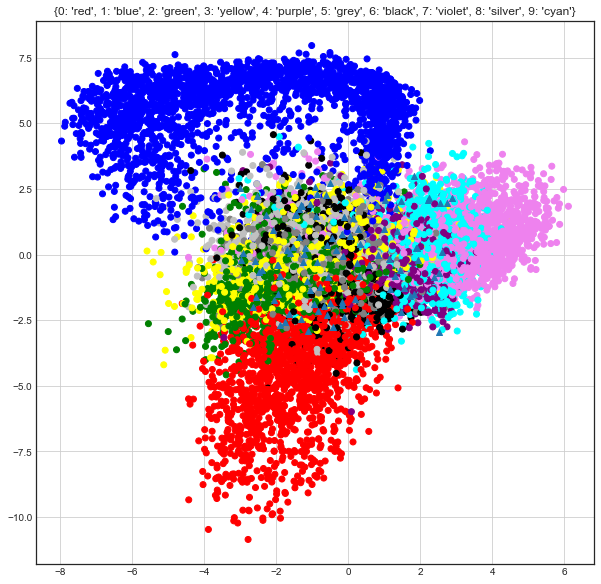

 iter: 10 batch: 19900 recon cost: 0.18437617 zero cost: 0.619335								 one  cost: 0.49467182 fake cost: 1.791428711

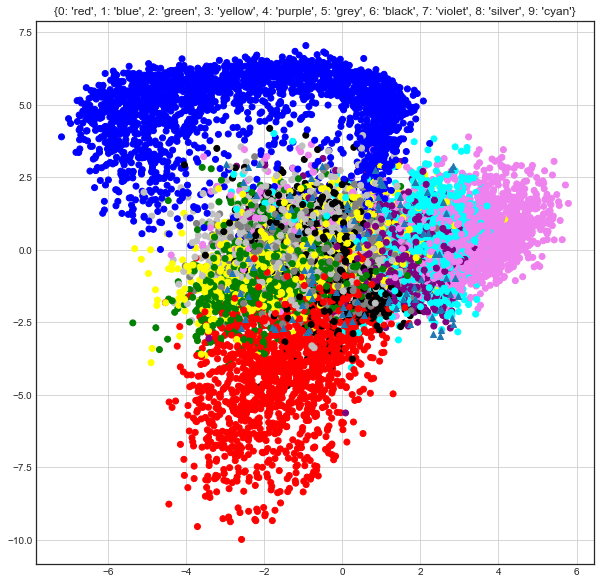

 iter: 11 batch: 19900 recon cost: 0.18401597 zero cost: 0.6431097								 one  cost: 0.46156204 fake cost: 1.67741328

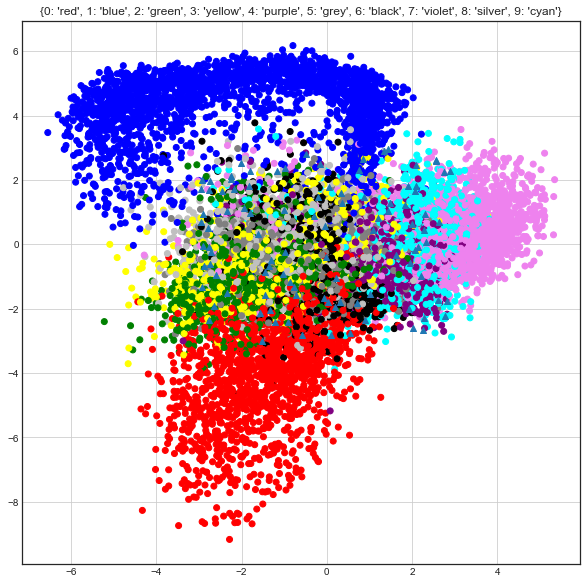

 iter: 12 batch: 19900 recon cost: 0.1838116 zero cost: 0.6532454								 one  cost: 0.57029676 fake cost: 1.499680243

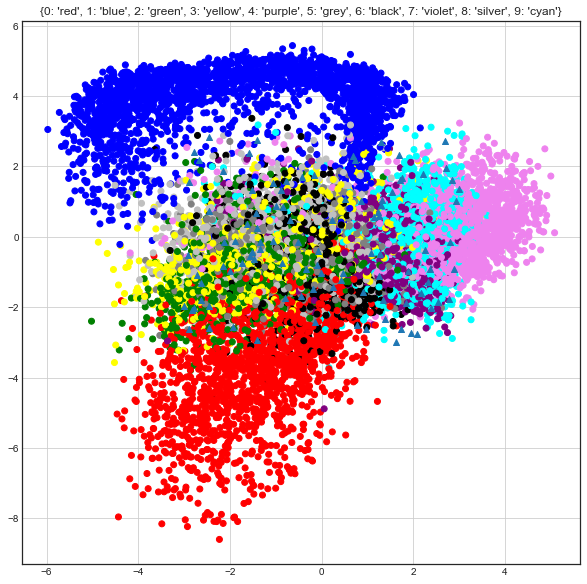

 iter: 13 batch: 19900 recon cost: 0.18352912 zero cost: 0.6812655								 one  cost: 0.43813694 fake cost: 1.33617665

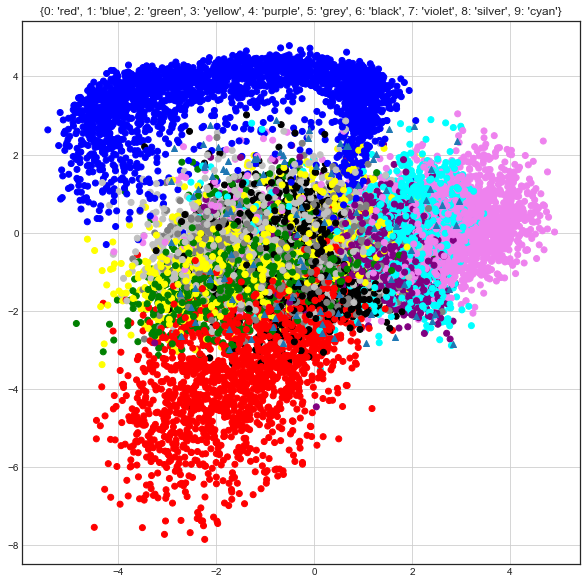

 iter: 14 batch: 19900 recon cost: 0.18312131 zero cost: 0.69003433								 one  cost: 0.4994072 fake cost: 1.27211949

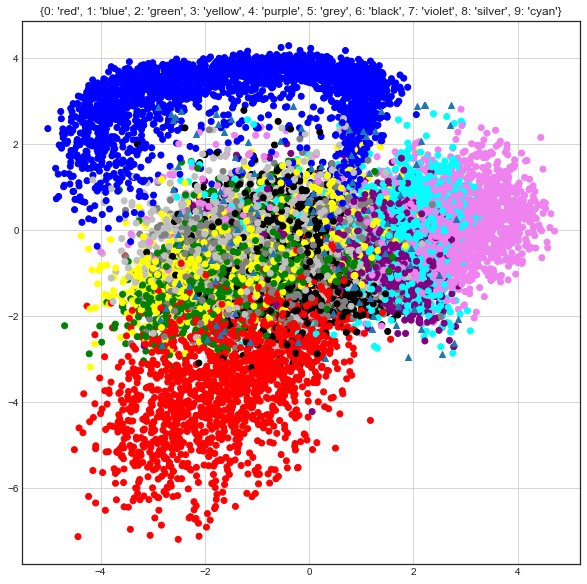

 iter: 15 batch: 19900 recon cost: 0.18272442 zero cost: 0.7073759								 one  cost: 0.4931653 fake cost: 1.143114634

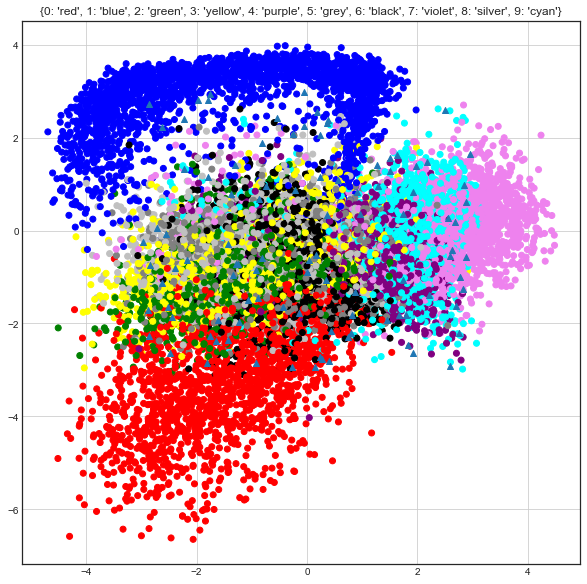

 iter: 16 batch: 19900 recon cost: 0.18262252 zero cost: 0.69552124								 one  cost: 0.5750055 fake cost: 1.12490074

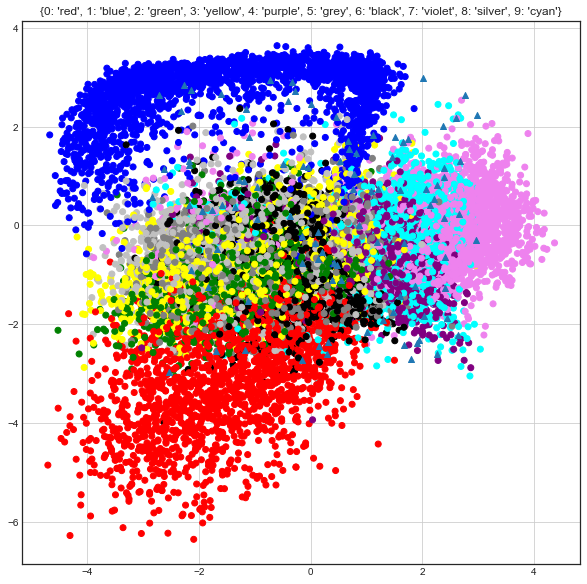

 iter: 17 batch: 19900 recon cost: 0.18180797 zero cost: 0.7282792								 one  cost: 0.567165 fake cost: 1.0339848238

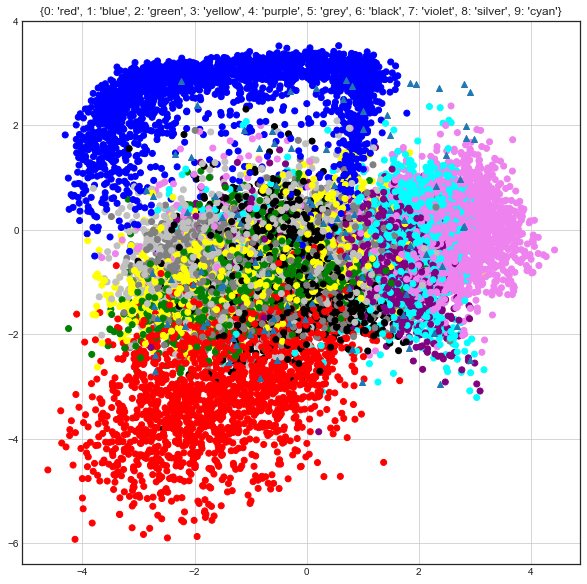

 iter: 18 batch: 19900 recon cost: 0.18142463 zero cost: 0.7073105								 one  cost: 0.4318077 fake cost: 1.034103532

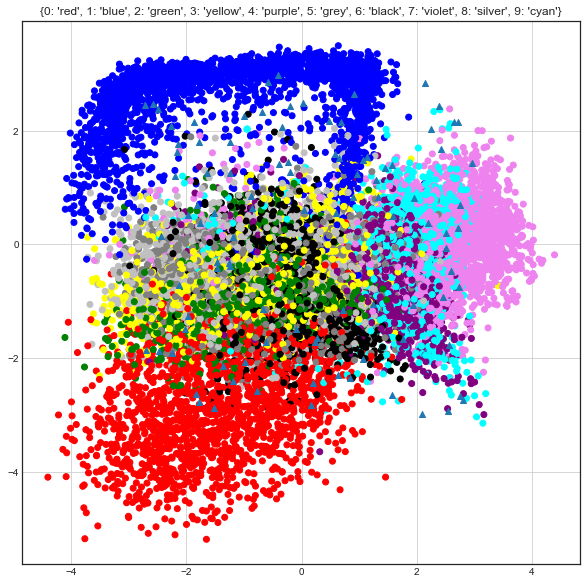

 iter: 19 batch: 19900 recon cost: 0.18098006 zero cost: 0.72297525								 one  cost: 0.5327612 fake cost: 0.994905826

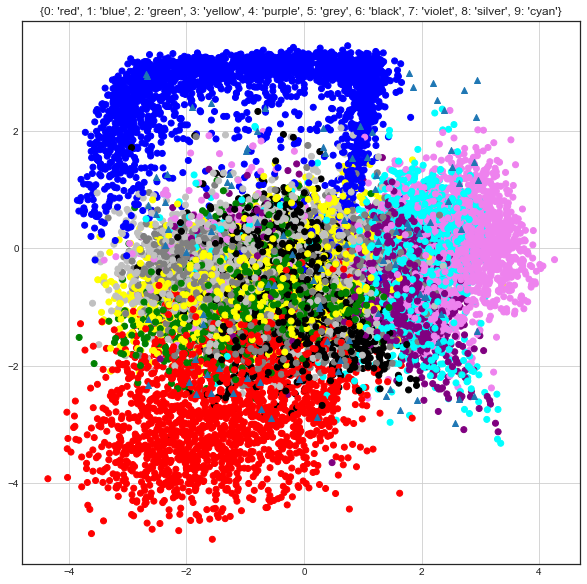

 iter: 20 batch: 19900 recon cost: 0.18044117 zero cost: 0.7294043								 one  cost: 0.5627811 fake cost: 0.971136458

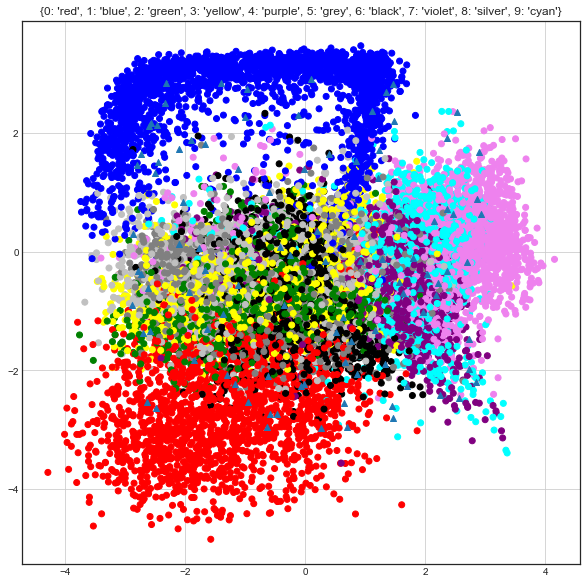

 iter: 21 batch: 19900 recon cost: 0.18028475 zero cost: 0.7325657								 one  cost: 0.5208094 fake cost: 0.944794548

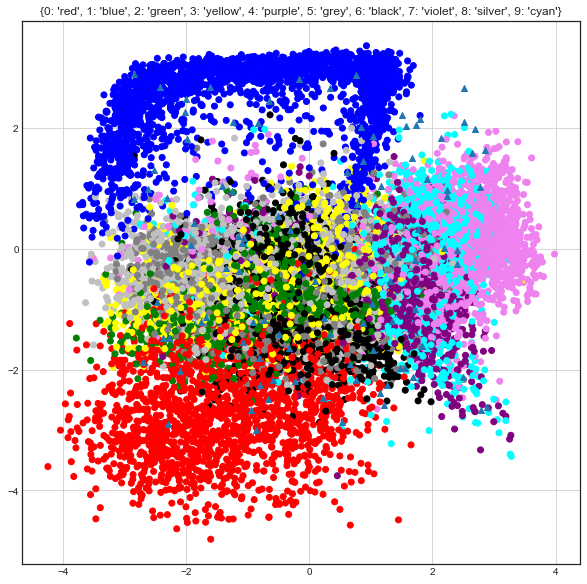

 iter: 22 batch: 19900 recon cost: 0.17991216 zero cost: 0.72766614								 one  cost: 0.5878025 fake cost: 0.93899122

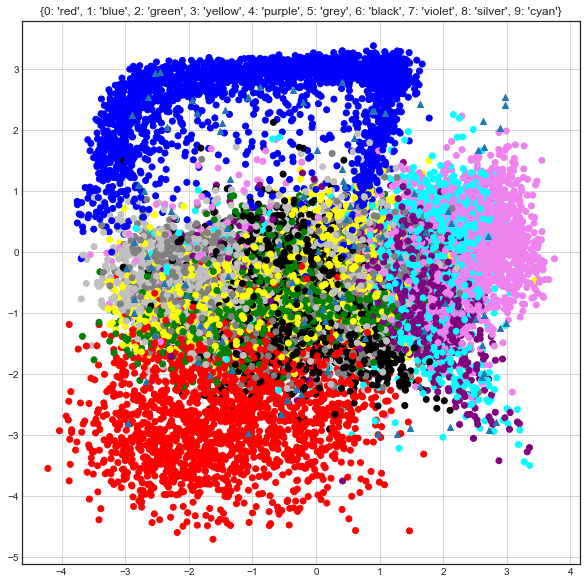

 iter: 23 batch: 19900 recon cost: 0.17940547 zero cost: 0.70650774								 one  cost: 0.6245445 fake cost: 0.96146025

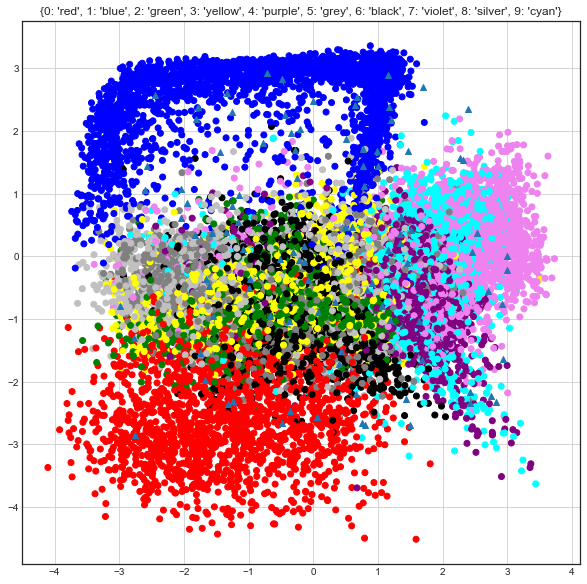

 iter: 24 batch: 19900 recon cost: 0.17892738 zero cost: 0.71823865								 one  cost: 0.6110469 fake cost: 0.92988724

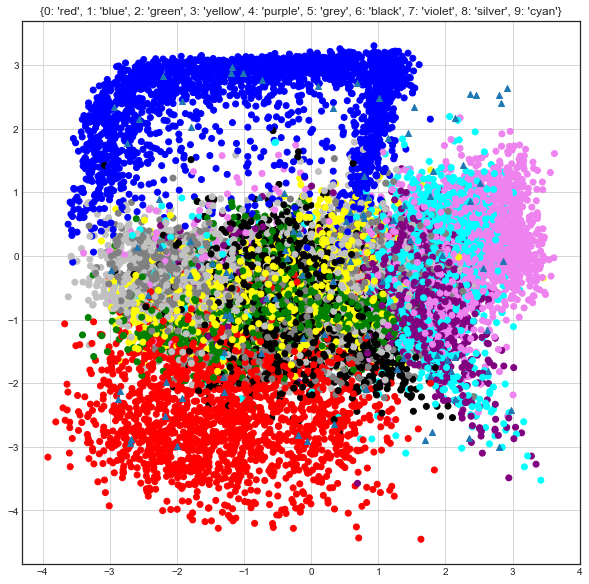

 iter: 25 batch: 19900 recon cost: 0.1785109 zero cost: 0.7138592								 one  cost: 0.5349762 fake cost: 0.9241527752

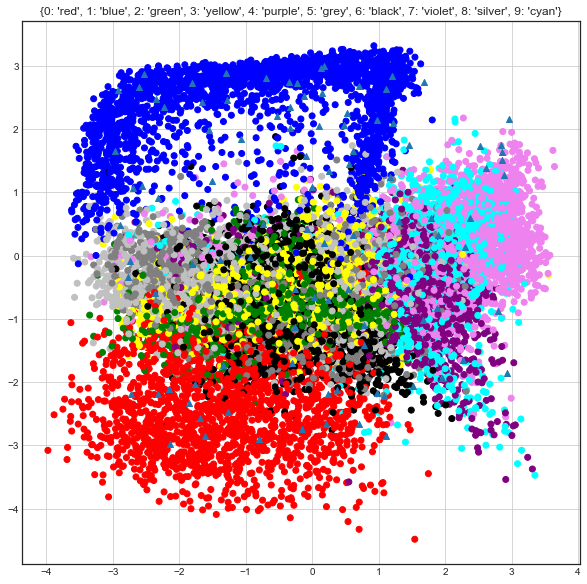

 iter: 26 batch: 19900 recon cost: 0.1780828 zero cost: 0.69862473								 one  cost: 0.5648532 fake cost: 0.942875748

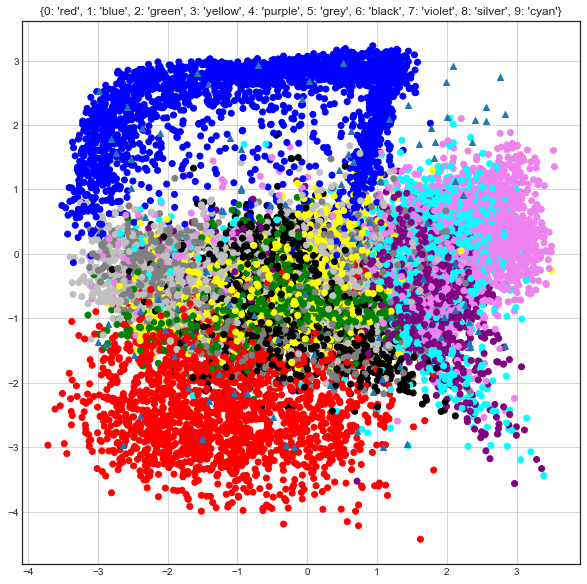

 iter: 27 batch: 19900 recon cost: 0.17765023 zero cost: 0.7130296								 one  cost: 0.5369103 fake cost: 0.907623772

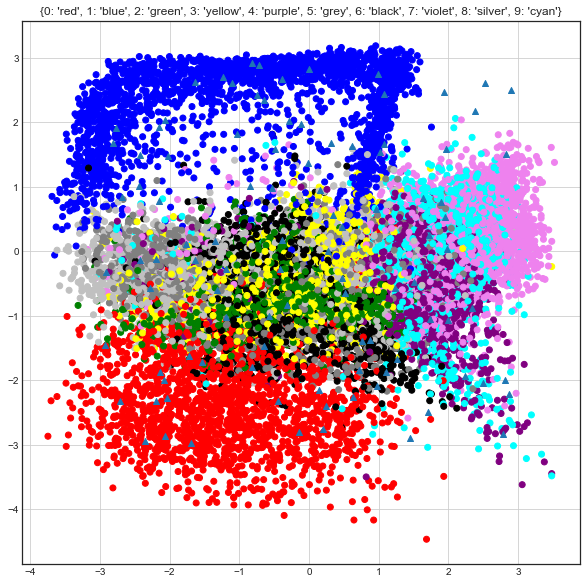

 iter: 28 batch: 19900 recon cost: 0.17716719 zero cost: 0.71590924								 one  cost: 0.5521023 fake cost: 0.913287867

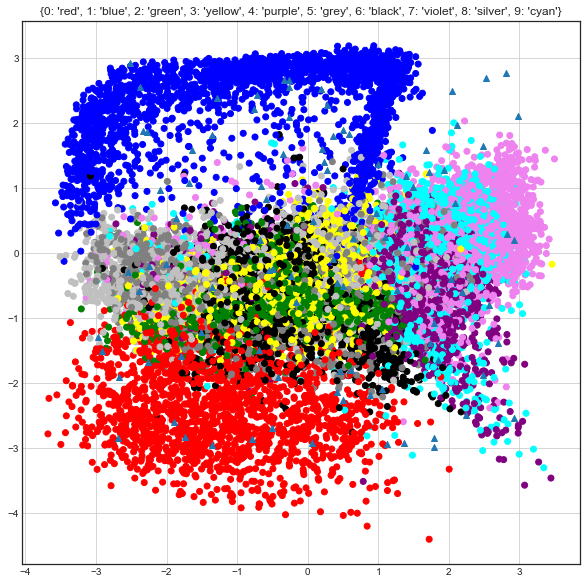

 iter: 29 batch: 19900 recon cost: 0.17676497 zero cost: 0.71406794								 one  cost: 0.56642425 fake cost: 0.9194652

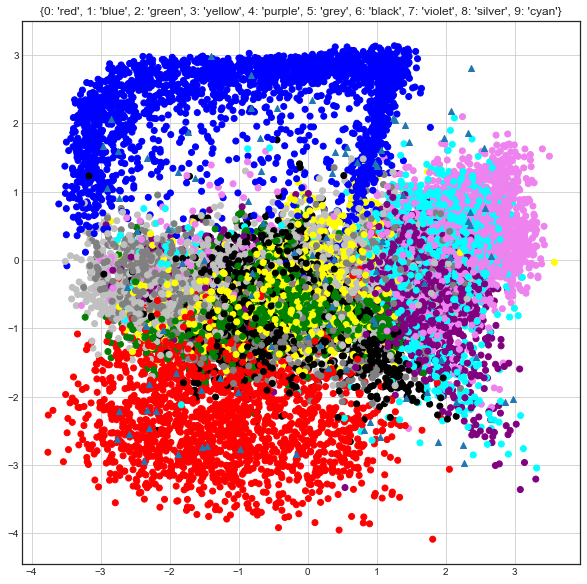

 iter: 30 batch: 19900 recon cost: 0.1763782 zero cost: 0.7152188								 one  cost: 0.5391334 fake cost: 0.89690817574

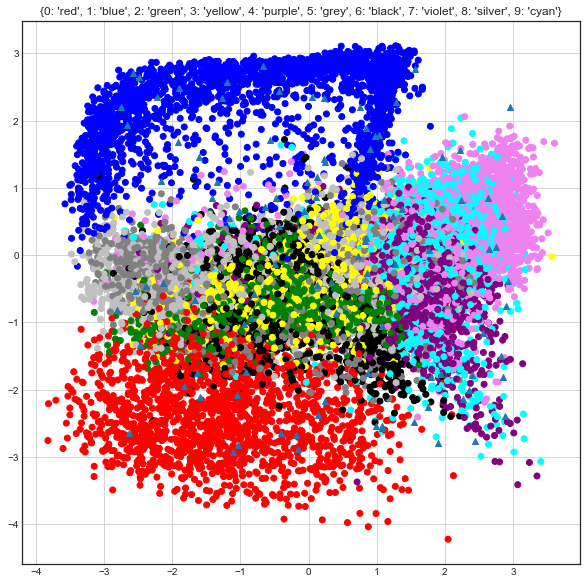

 iter: 31 batch: 19900 recon cost: 0.17603196 zero cost: 0.7331305								 one  cost: 0.55576354 fake cost: 0.86998194

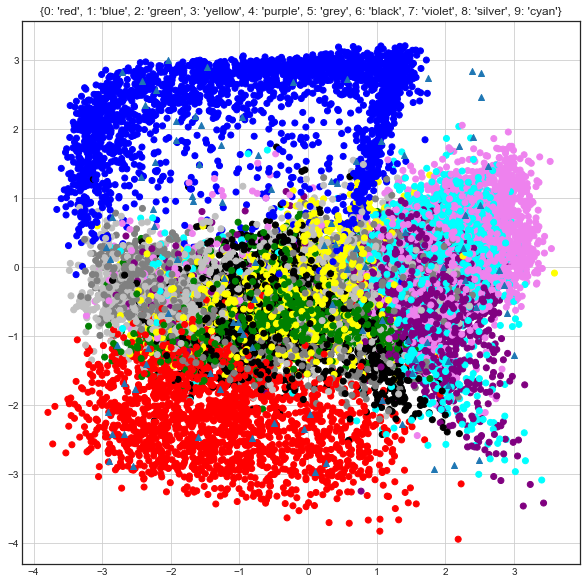

 iter: 32 batch: 19900 recon cost: 0.17551626 zero cost: 0.69146955								 one  cost: 0.55750257 fake cost: 0.90554696

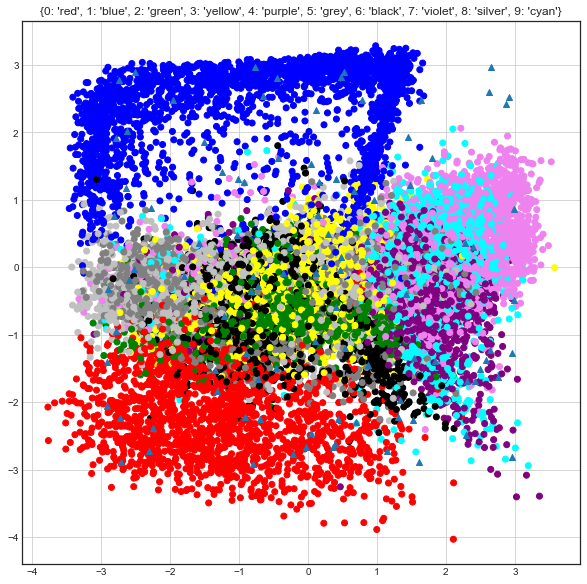

 iter: 33 batch: 19900 recon cost: 0.17515984 zero cost: 0.6901702								 one  cost: 0.5620977 fake cost: 0.913729254

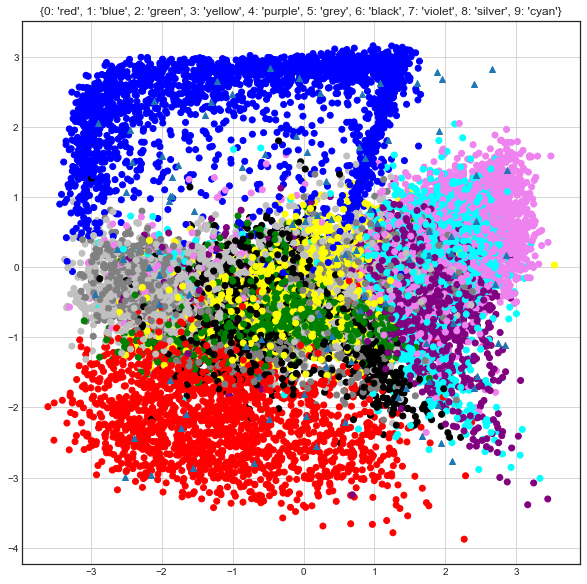

 iter: 34 batch: 19900 recon cost: 0.17476127 zero cost: 0.6757044								 one  cost: 0.54826987 fake cost: 0.93642594

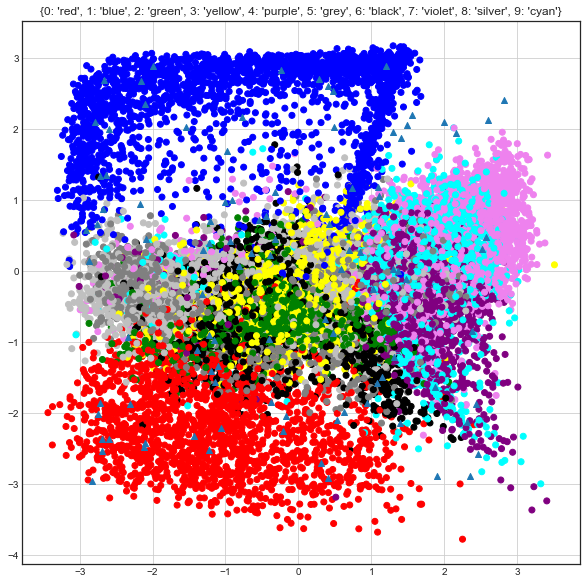

 iter: 35 batch: 19900 recon cost: 0.17449662 zero cost: 0.67790467								 one  cost: 0.63898814 fake cost: 0.92742586

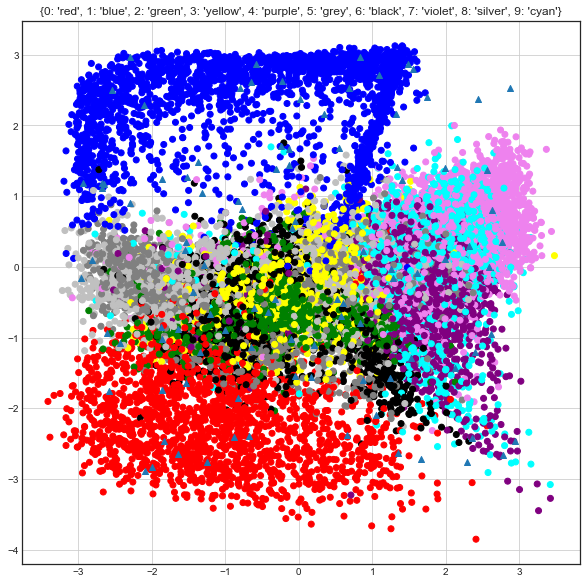

 iter: 36 batch: 19900 recon cost: 0.17416367 zero cost: 0.6844377								 one  cost: 0.57654285 fake cost: 0.92729723

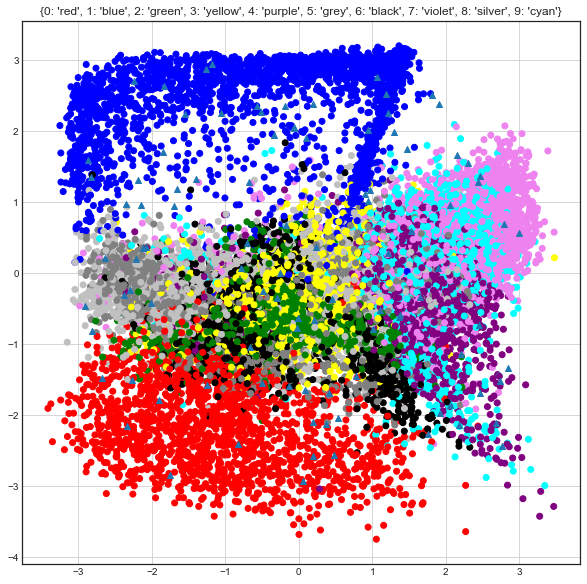

 iter: 37 batch: 19900 recon cost: 0.17373593 zero cost: 0.68498063								 one  cost: 0.571949 fake cost: 0.915241962

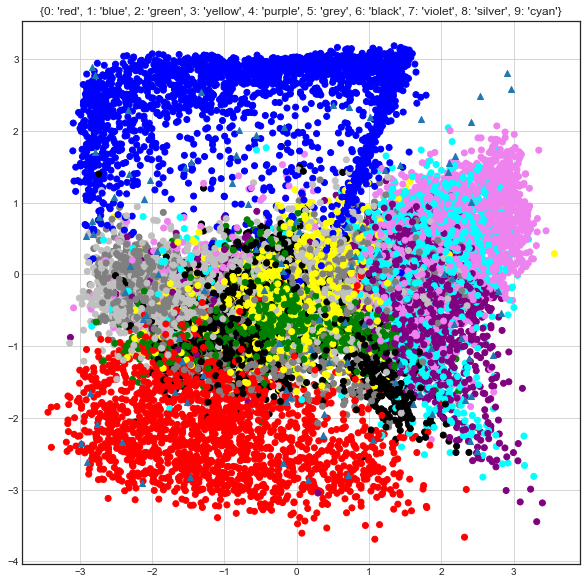

 iter: 38 batch: 19900 recon cost: 0.17335878 zero cost: 0.6752252								 one  cost: 0.6009483 fake cost: 0.9248734336

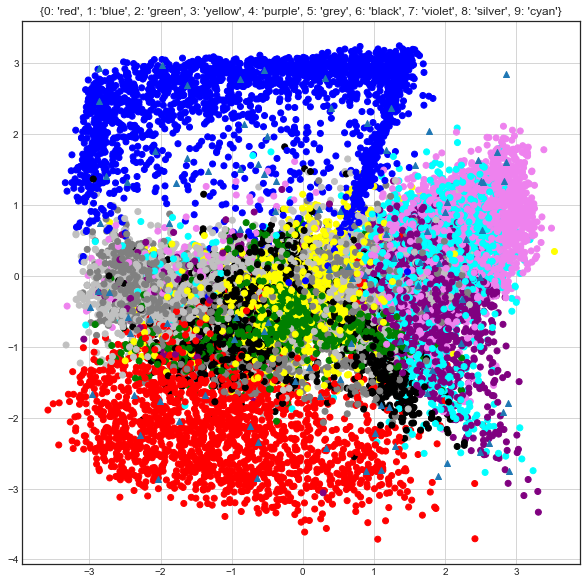

 iter: 39 batch: 19900 recon cost: 0.17323564 zero cost: 0.6609505								 one  cost: 0.5948851 fake cost: 0.935897052

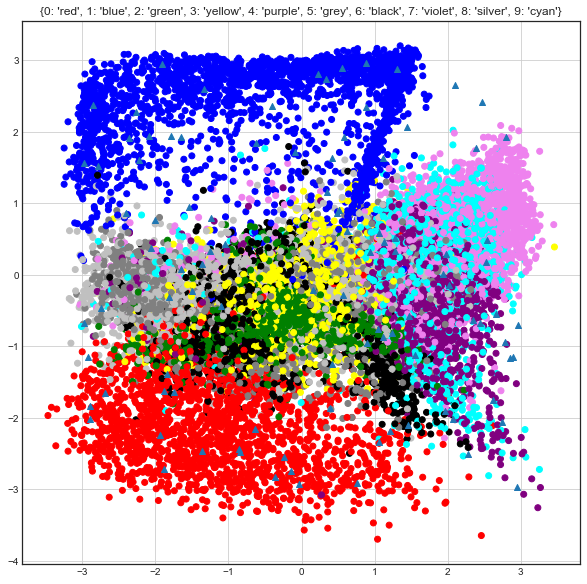

 iter: 40 batch: 19900 recon cost: 0.17298143 zero cost: 0.63640904								 one  cost: 0.5991575 fake cost: 0.96819266

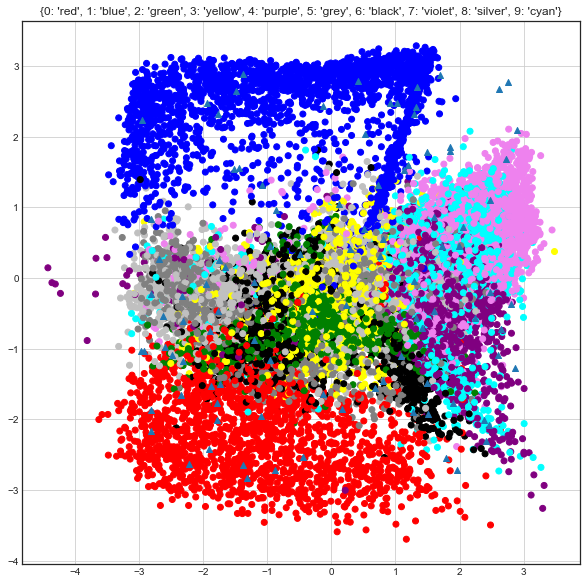

 iter: 41 batch: 19900 recon cost: 0.17264529 zero cost: 0.6748486								 one  cost: 0.541357 fake cost: 0.9207852746

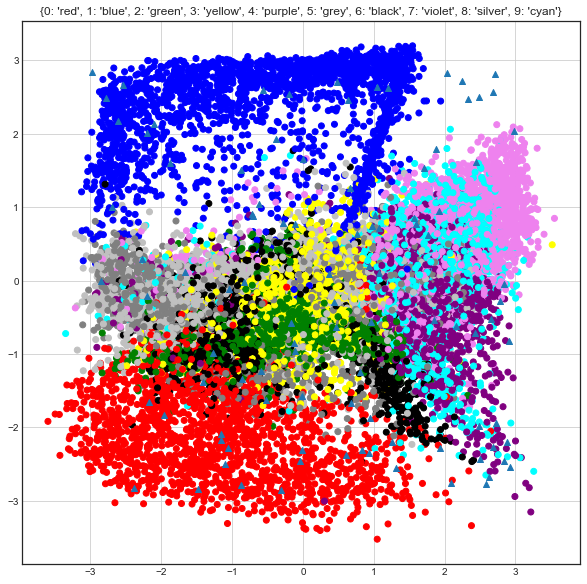

 iter: 42 batch: 19900 recon cost: 0.17250988 zero cost: 0.6783922								 one  cost: 0.6055895 fake cost: 0.9236036537

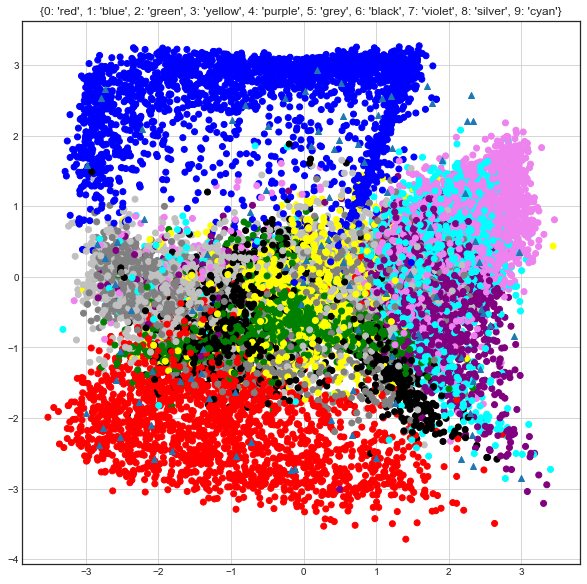

 iter: 43 batch: 19900 recon cost: 0.17214315 zero cost: 0.67623335								 one  cost: 0.56388795 fake cost: 0.91334015

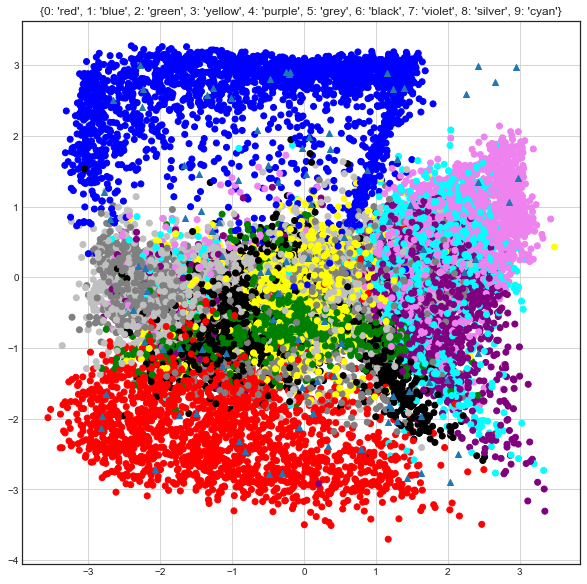

 iter: 44 batch: 19900 recon cost: 0.17175424 zero cost: 0.67974955								 one  cost: 0.55727655 fake cost: 0.90881205

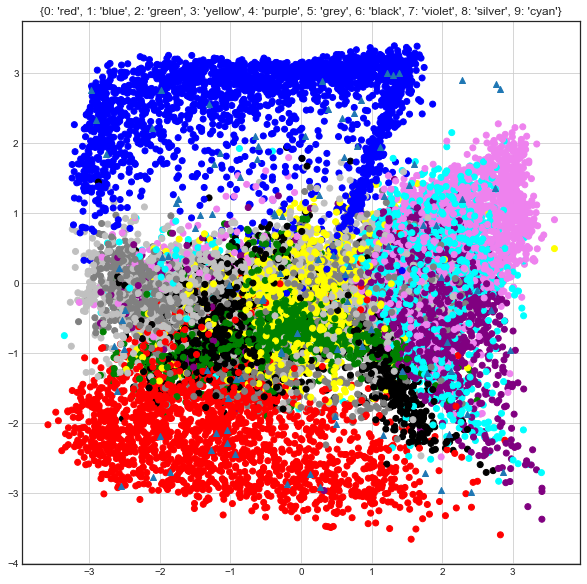

 iter: 45 batch: 19900 recon cost: 0.17168692 zero cost: 0.67119247								 one  cost: 0.6503688 fake cost: 0.922133765

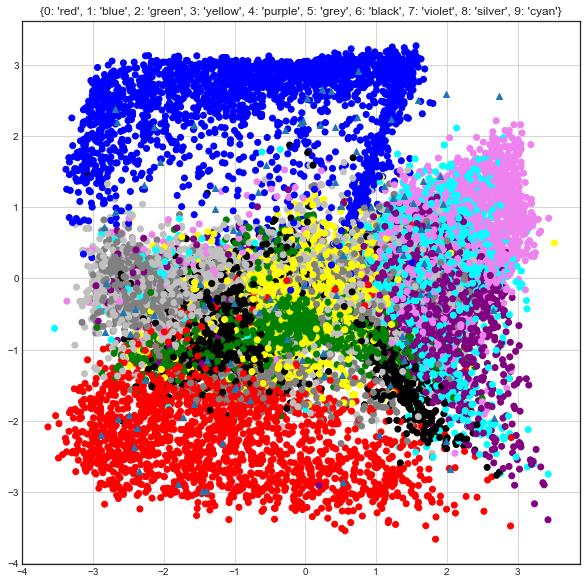

 iter: 46 batch: 19900 recon cost: 0.17149508 zero cost: 0.6519066								 one  cost: 0.63079226 fake cost: 0.94990214

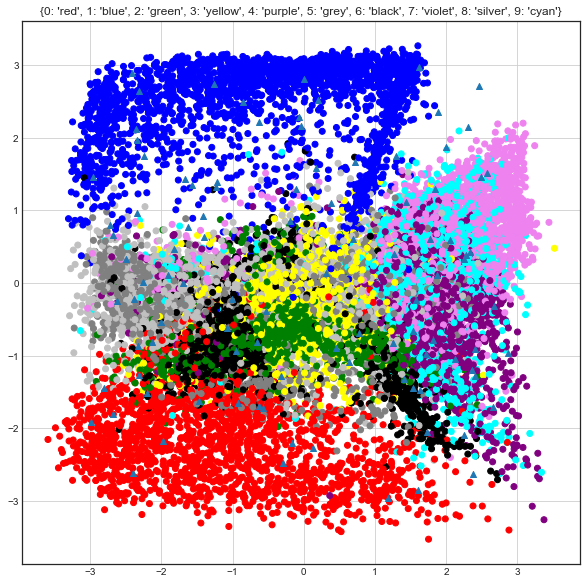

 iter: 47 batch: 19900 recon cost: 0.1712035 zero cost: 0.66762376								 one  cost: 0.5745399 fake cost: 0.932370846

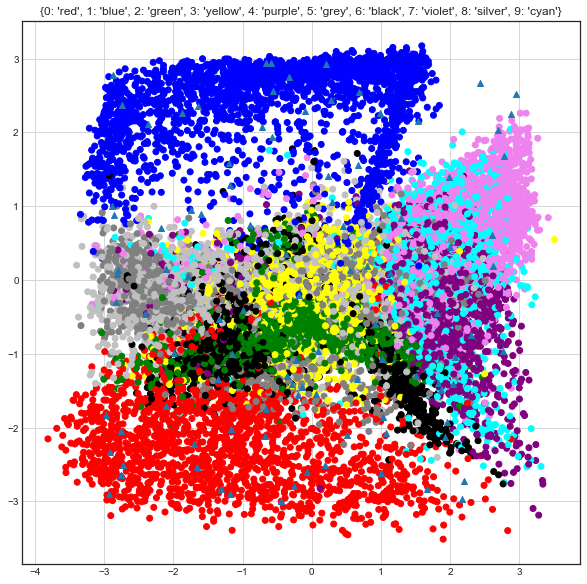

 iter: 48 batch: 19900 recon cost: 0.17100357 zero cost: 0.65781754								 one  cost: 0.641586 fake cost: 0.933064799

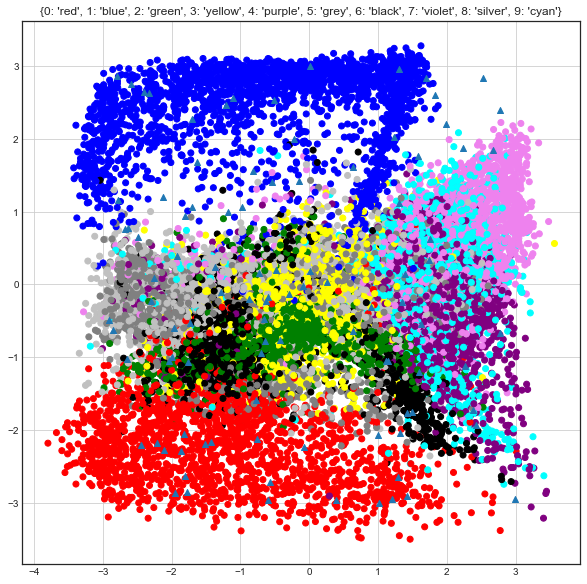

 iter: 49 batch: 19900 recon cost: 0.17067662 zero cost: 0.6267133								 one  cost: 0.62511754 fake cost: 0.974887856

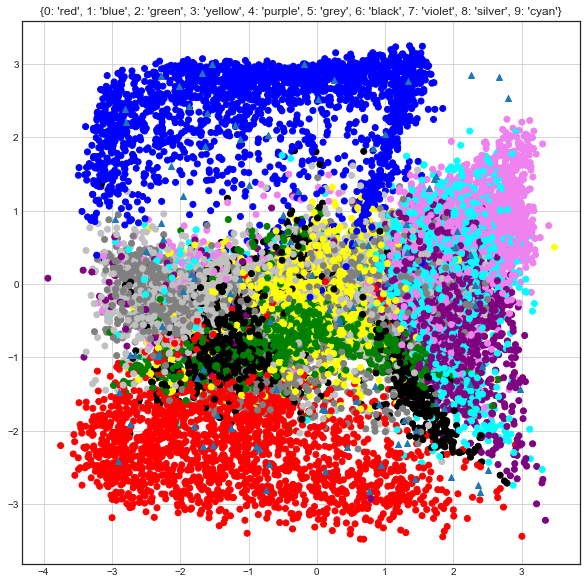

 iter: 50 batch: 19900 recon cost: 0.17028438 zero cost: 0.64531416								 one  cost: 0.6305273 fake cost: 0.93784577

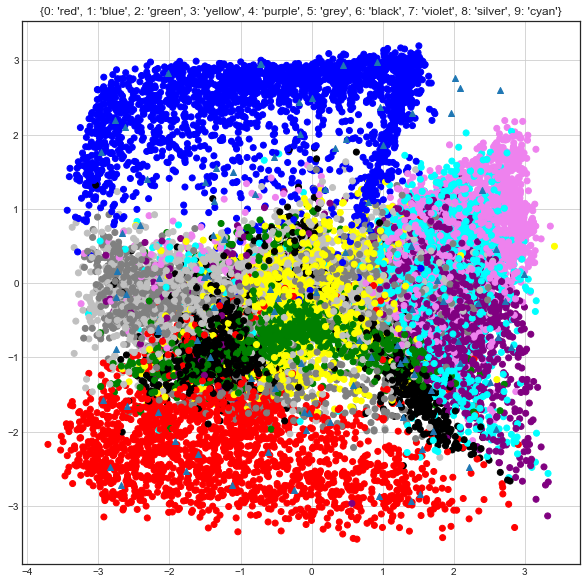

 iter: 51 batch: 19900 recon cost: 0.16994609 zero cost: 0.6475842								 one  cost: 0.6211064 fake cost: 0.936899478

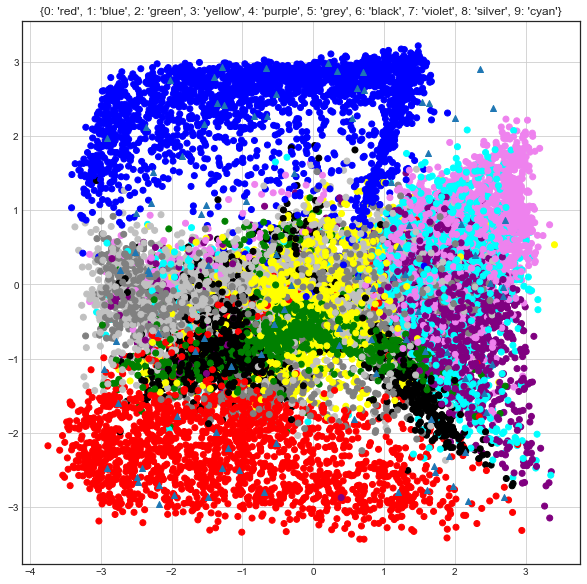

 iter: 52 batch: 19900 recon cost: 0.16976388 zero cost: 0.6358767								 one  cost: 0.6459729 fake cost: 0.9532712765

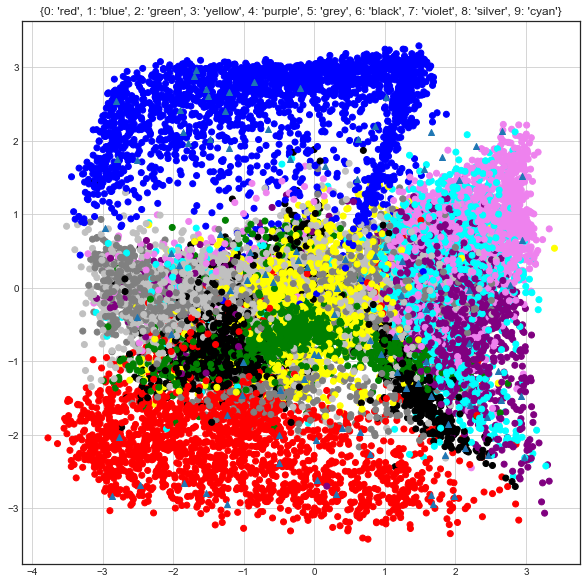

 iter: 53 batch: 19900 recon cost: 0.16961688 zero cost: 0.62475497								 one  cost: 0.6134192 fake cost: 0.990903856

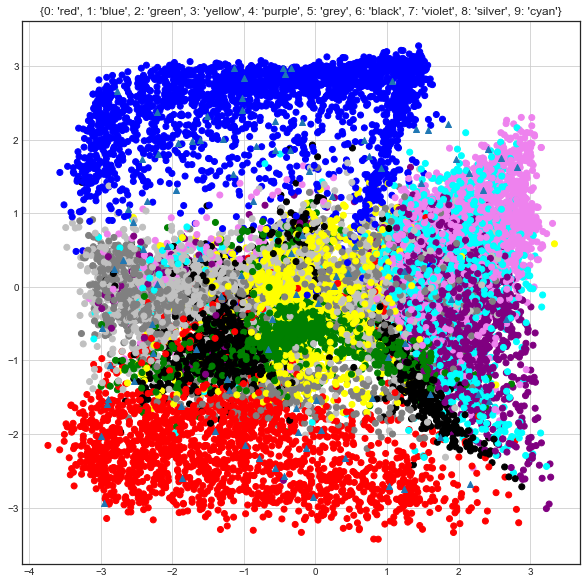

 iter: 54 batch: 19900 recon cost: 0.16933905 zero cost: 0.6490315								 one  cost: 0.62772816 fake cost: 0.94737715

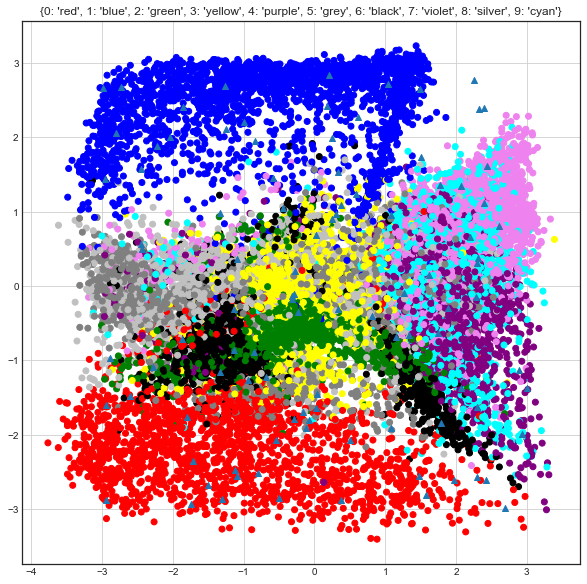

 iter: 55 batch: 19900 recon cost: 0.16935053 zero cost: 0.6167279								 one  cost: 0.58132124 fake cost: 0.990793335

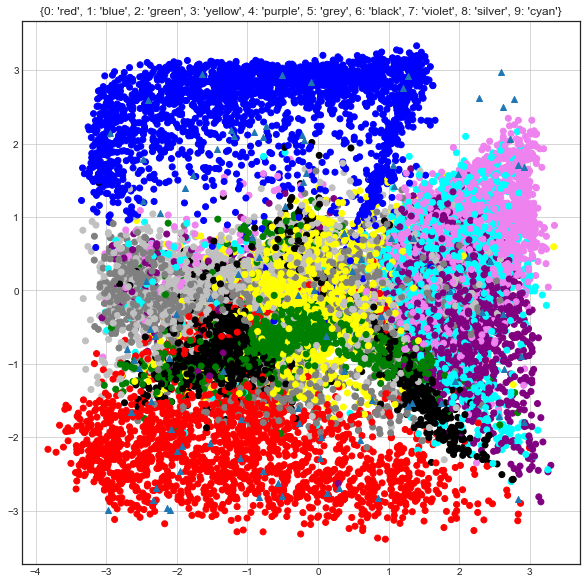

 iter: 56 batch: 19900 recon cost: 0.1690465 zero cost: 0.6322838								 one  cost: 0.6597956 fake cost: 1.00682567696

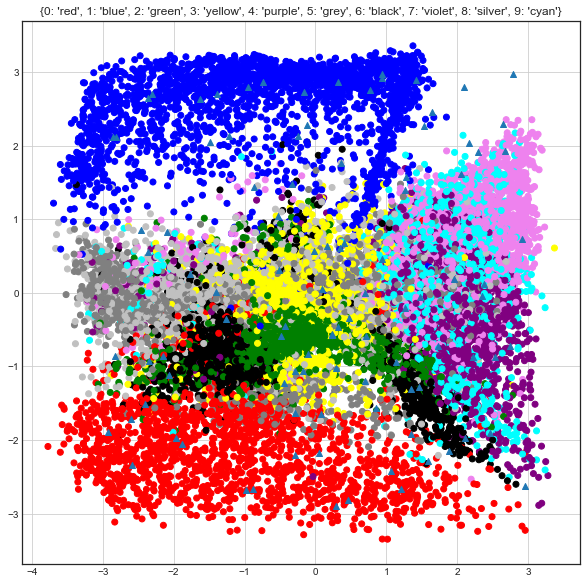

 iter: 57 batch: 19900 recon cost: 0.16875222 zero cost: 0.638477								 one  cost: 0.57933676 fake cost: 0.9504895674

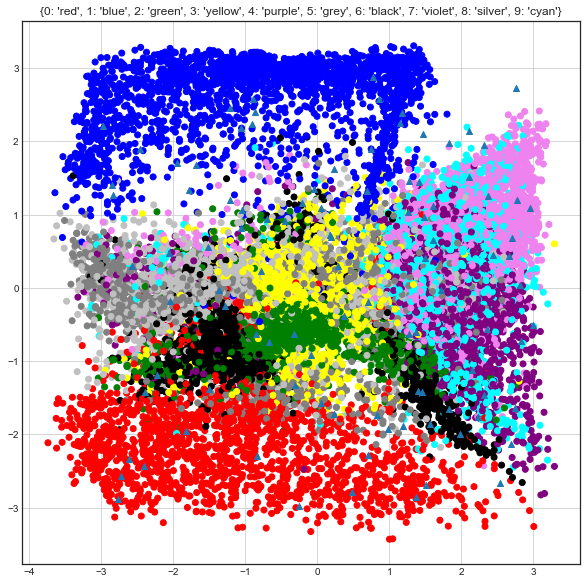

 iter: 58 batch: 19900 recon cost: 0.16837342 zero cost: 0.6457609								 one  cost: 0.6888249 fake cost: 0.9601138954

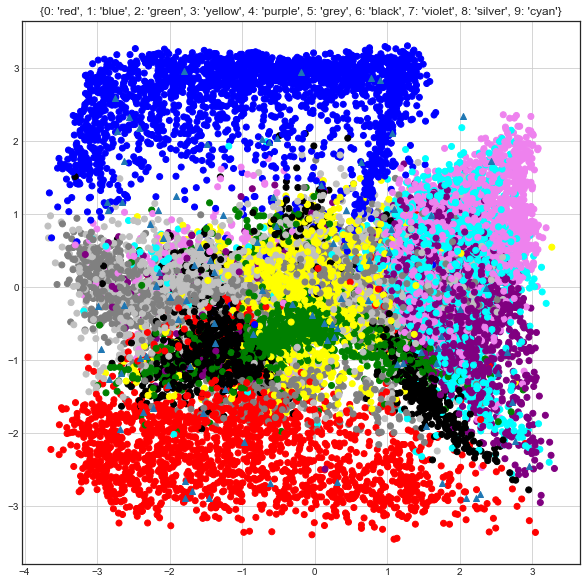

 iter: 59 batch: 19900 recon cost: 0.16816041 zero cost: 0.6490213								 one  cost: 0.63237786 fake cost: 0.94951926

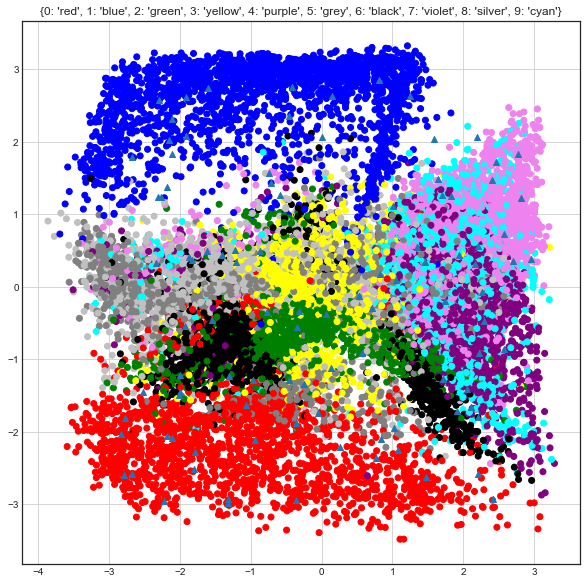

 iter: 60 batch: 19900 recon cost: 0.16802612 zero cost: 0.67417145								 one  cost: 0.5780451 fake cost: 0.907244566

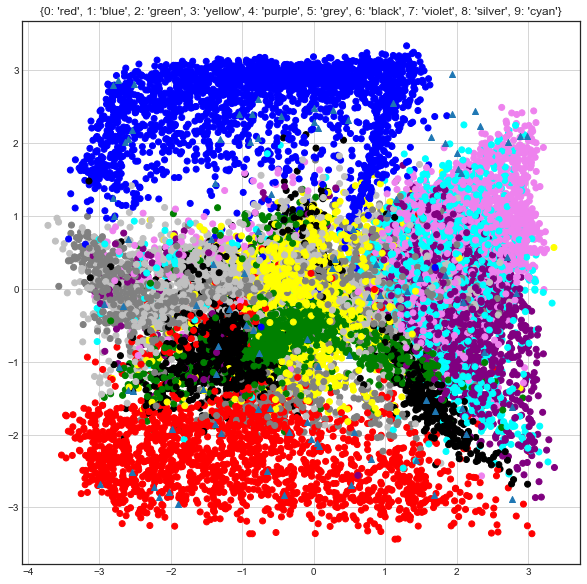

 iter: 61 batch: 19900 recon cost: 0.16783927 zero cost: 0.6570284								 one  cost: 0.60113615 fake cost: 0.917375865

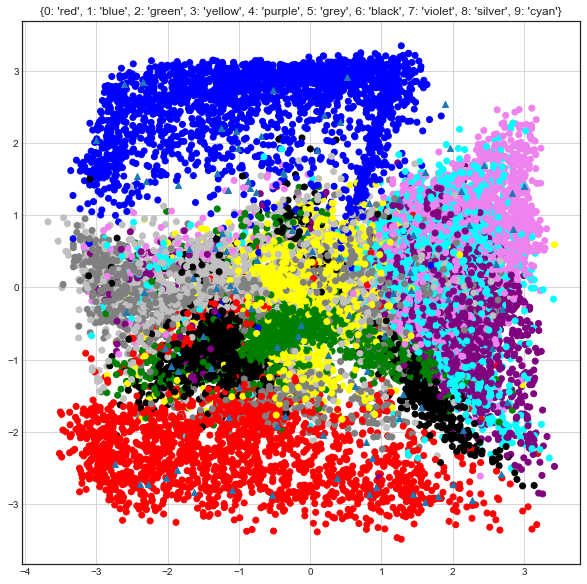

 iter: 62 batch: 19900 recon cost: 0.16774242 zero cost: 0.6343162								 one  cost: 0.6423774 fake cost: 0.944391554

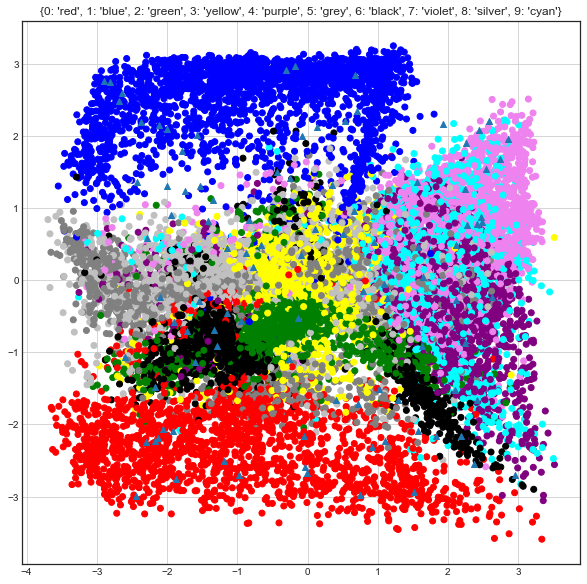

 iter: 63 batch: 19900 recon cost: 0.16773362 zero cost: 0.6805801								 one  cost: 0.651372 fake cost: 0.89299437474

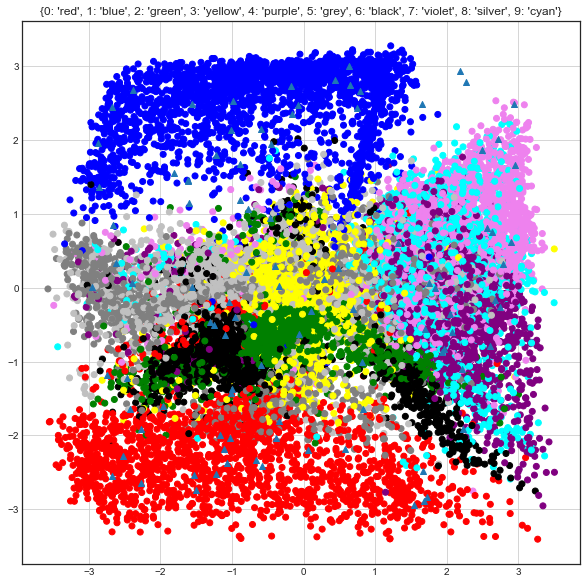

 iter: 64 batch: 19900 recon cost: 0.16713794 zero cost: 0.63698083								 one  cost: 0.6004732 fake cost: 0.94900217

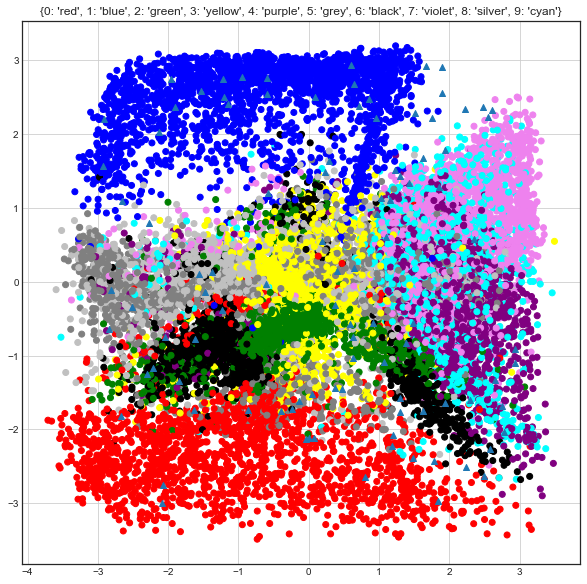

 iter: 65 batch: 19900 recon cost: 0.16686438 zero cost: 0.663548								 one  cost: 0.56970924 fake cost: 0.9110004475

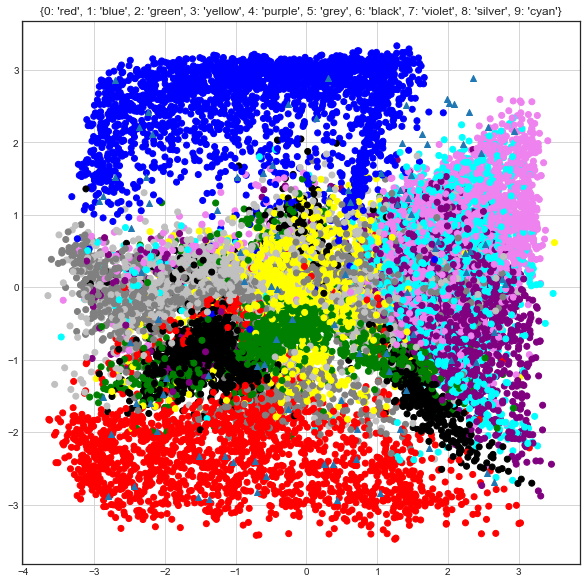

 iter: 66 batch: 19900 recon cost: 0.16657075 zero cost: 0.64545417								 one  cost: 0.5855197 fake cost: 0.920485265

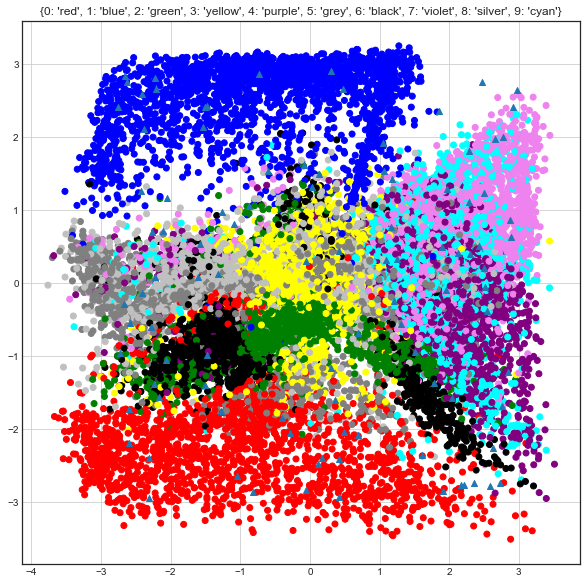

 iter: 67 batch: 19900 recon cost: 0.16634265 zero cost: 0.6328896								 one  cost: 0.6523844 fake cost: 0.9363304425

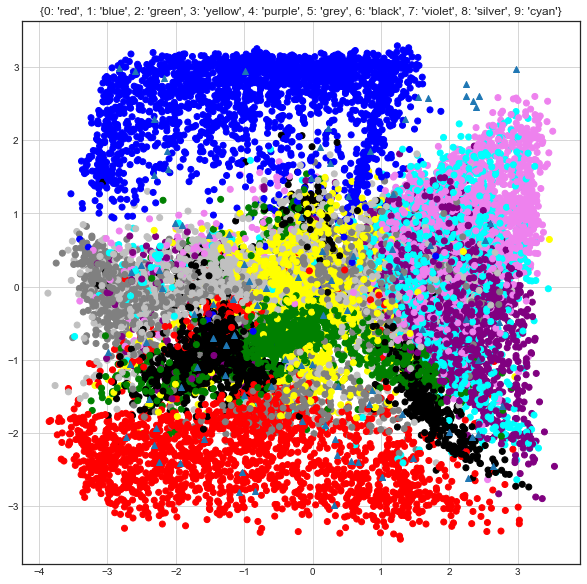

 iter: 68 batch: 19900 recon cost: 0.16608177 zero cost: 0.672591								 one  cost: 0.6084734 fake cost: 0.89720438394

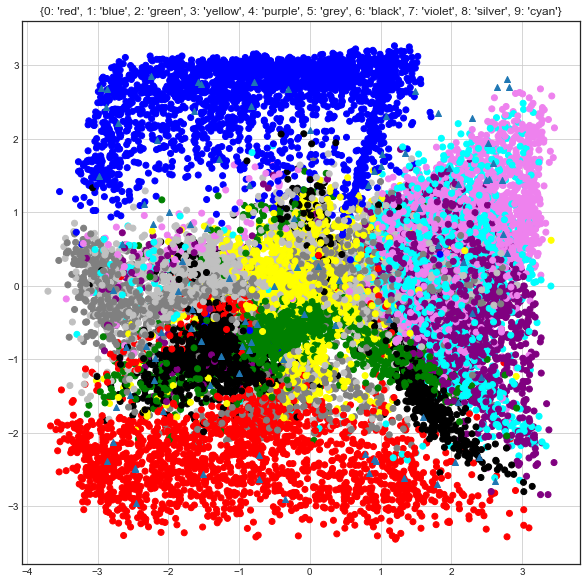

 iter: 69 batch: 19900 recon cost: 0.16594392 zero cost: 0.6805925								 one  cost: 0.6499451 fake cost: 0.876375784

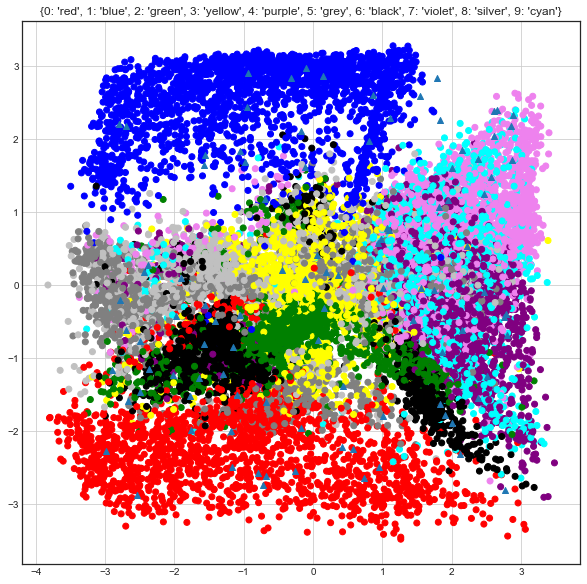

 iter: 70 batch: 19900 recon cost: 0.1658444 zero cost: 0.66888314								 one  cost: 0.6601803 fake cost: 0.8838511174

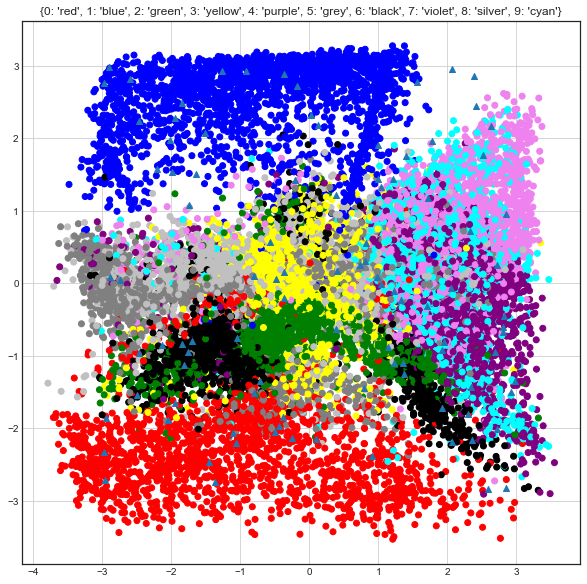

 iter: 71 batch: 19900 recon cost: 0.16549006 zero cost: 0.65912								 one  cost: 0.5956701 fake cost: 0.909296441833

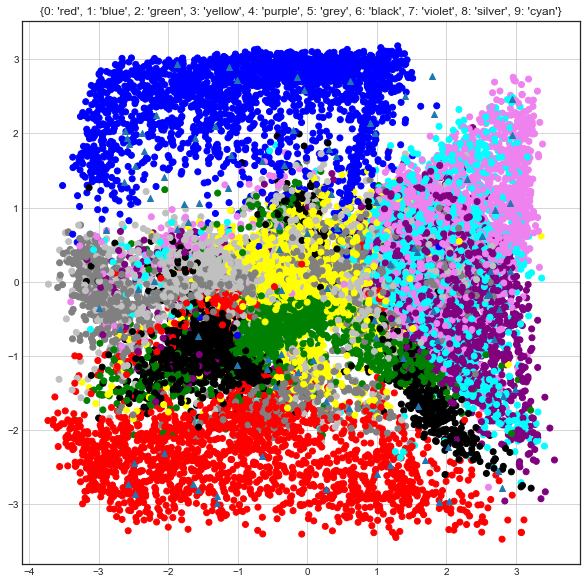

 iter: 72 batch: 19900 recon cost: 0.16532479 zero cost: 0.67881525								 one  cost: 0.6049979 fake cost: 0.878133566

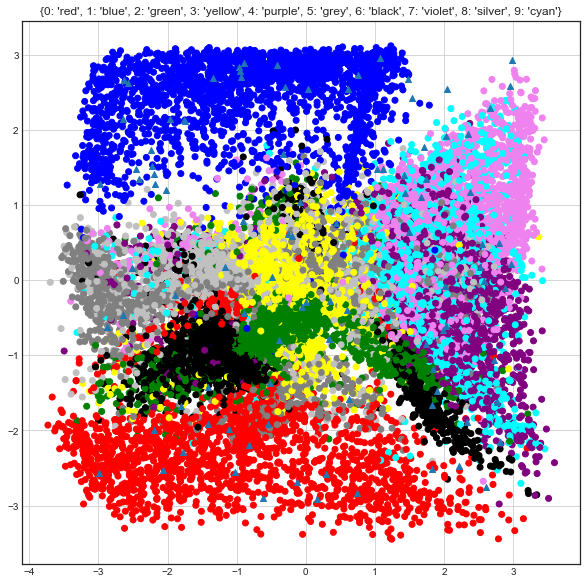

 iter: 73 batch: 19900 recon cost: 0.16504055 zero cost: 0.70945024								 one  cost: 0.61508554 fake cost: 0.84441495

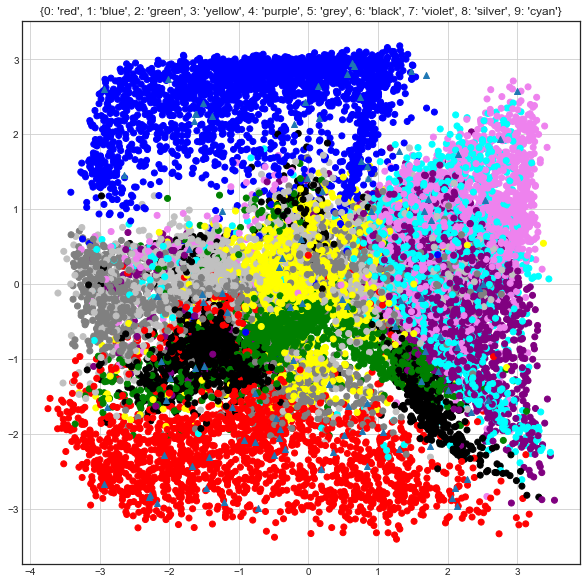

 iter: 74 batch: 19900 recon cost: 0.16492231 zero cost: 0.6950186								 one  cost: 0.5678755 fake cost: 0.8481589675

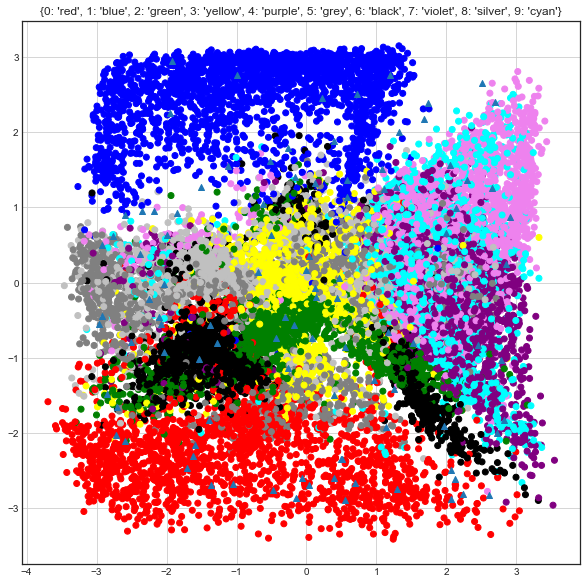

 iter: 75 batch: 19900 recon cost: 0.16467905 zero cost: 0.6648627								 one  cost: 0.6844973 fake cost: 0.8903703827

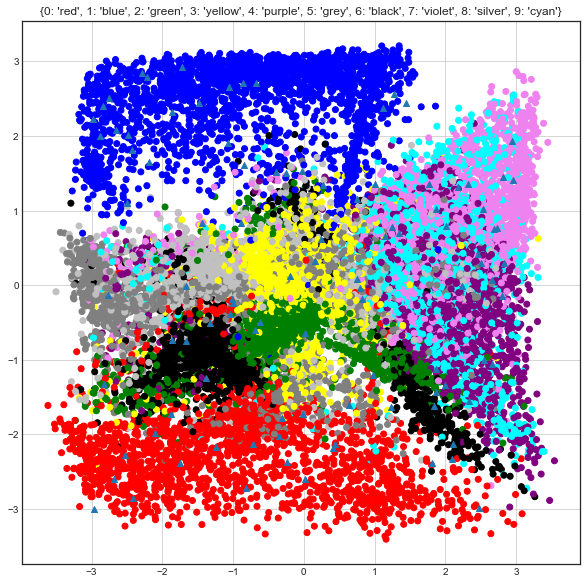

 iter: 76 batch: 19900 recon cost: 0.1645109 zero cost: 0.67025286								 one  cost: 0.6324209 fake cost: 0.8605493353

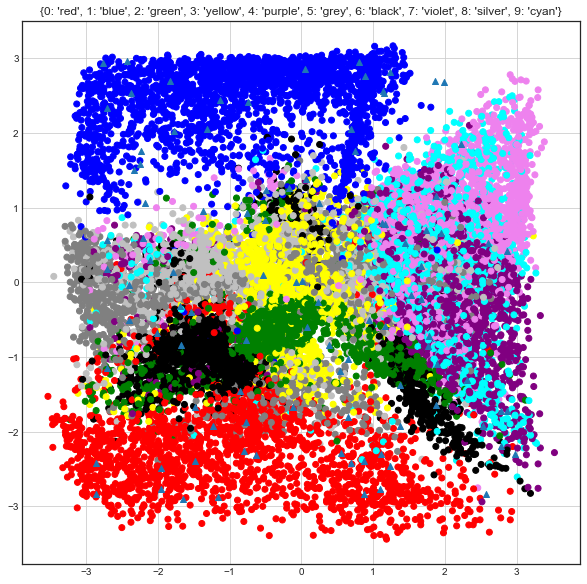

 iter: 77 batch: 19900 recon cost: 0.16437301 zero cost: 0.66334414								 one  cost: 0.6227739 fake cost: 0.880047275

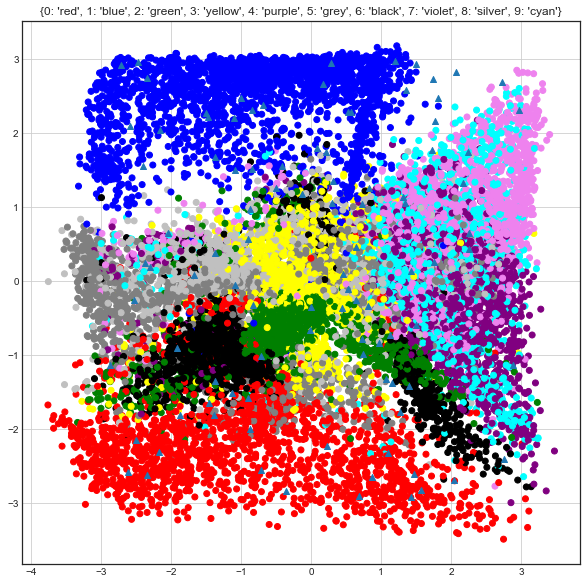

 iter: 78 batch: 19900 recon cost: 0.16420496 zero cost: 0.68884987								 one  cost: 0.55578715 fake cost: 0.86023653

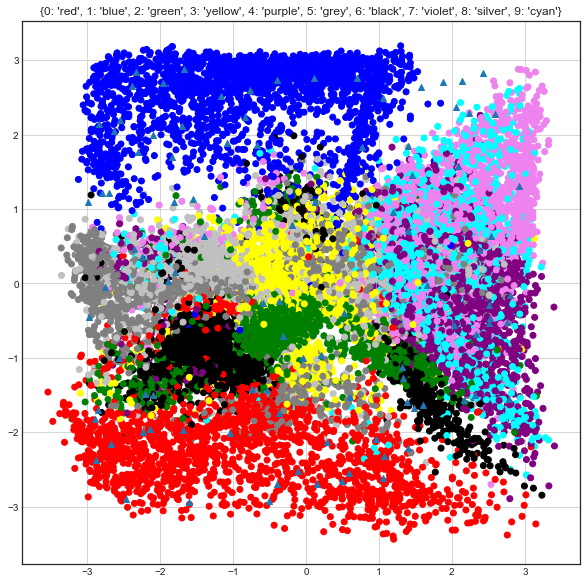

 iter: 79 batch: 19900 recon cost: 0.16412044 zero cost: 0.6421101								 one  cost: 0.6264114 fake cost: 0.9076758625

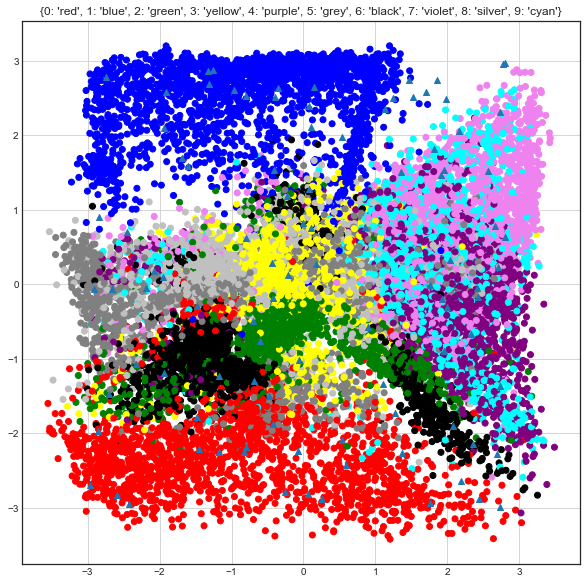

 iter: 80 batch: 19900 recon cost: 0.16382234 zero cost: 0.6842517								 one  cost: 0.6249605 fake cost: 0.8686092597

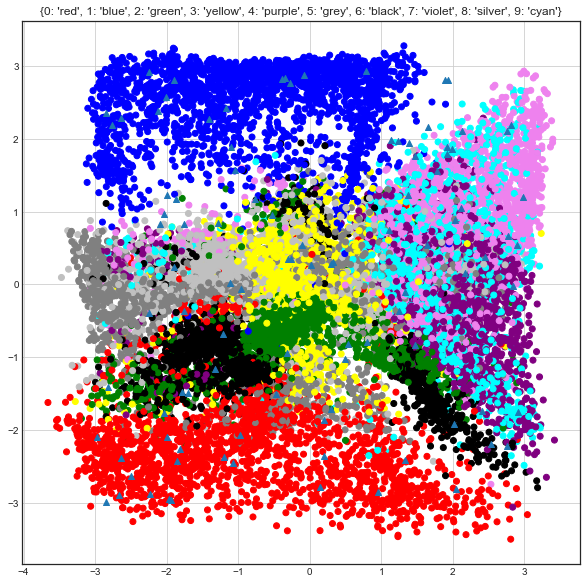

 iter: 81 batch: 19900 recon cost: 0.16364266 zero cost: 0.65740854								 one  cost: 0.6503381 fake cost: 0.889120164

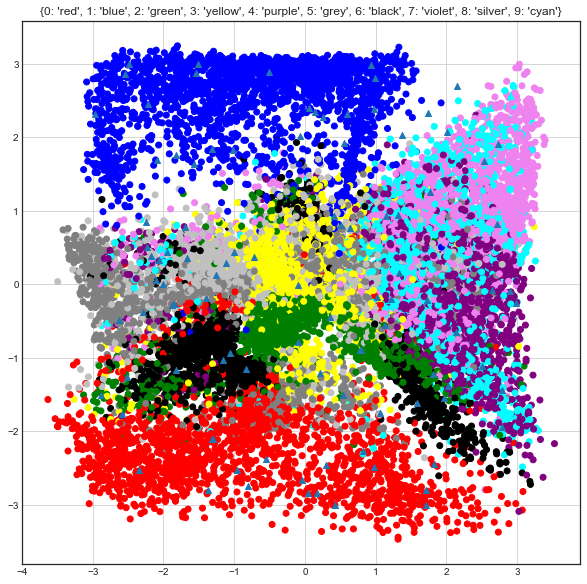

 iter: 82 batch: 19900 recon cost: 0.16371043 zero cost: 0.65310645								 one  cost: 0.6347755 fake cost: 0.898675443

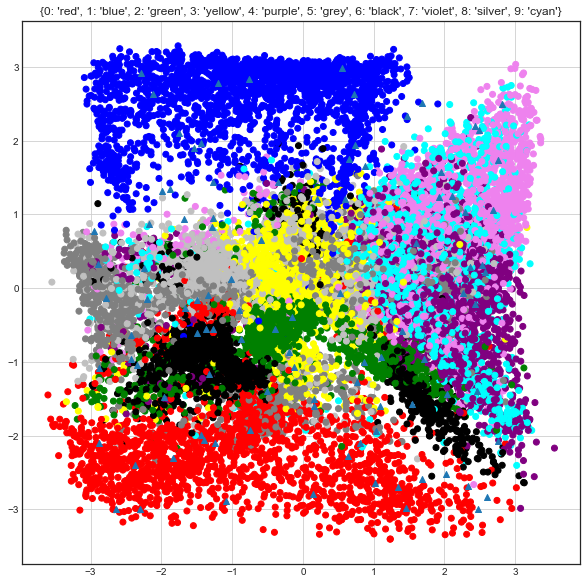

 iter: 83 batch: 19900 recon cost: 0.16357853 zero cost: 0.6667685								 one  cost: 0.6097759 fake cost: 0.8898198664

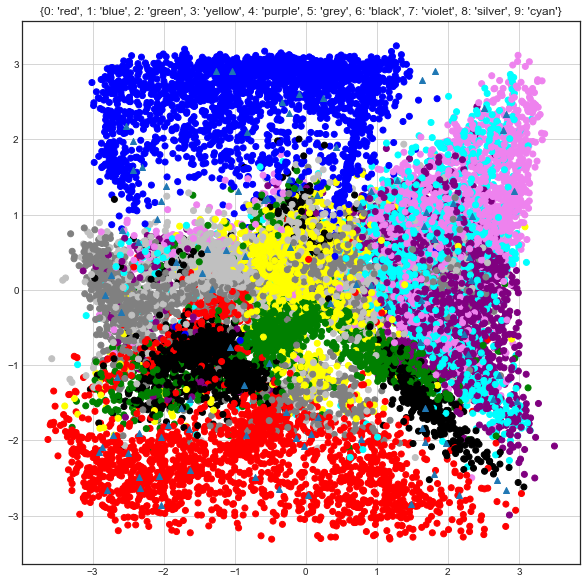

 iter: 84 batch: 19900 recon cost: 0.16342159 zero cost: 0.65658796								 one  cost: 0.6274399 fake cost: 0.900827246

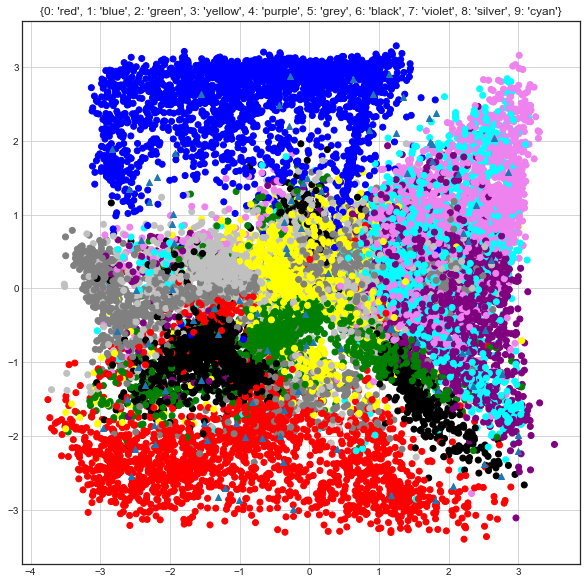

 iter: 85 batch: 19900 recon cost: 0.16329807 zero cost: 0.6454351								 one  cost: 0.7033617 fake cost: 0.9125198134

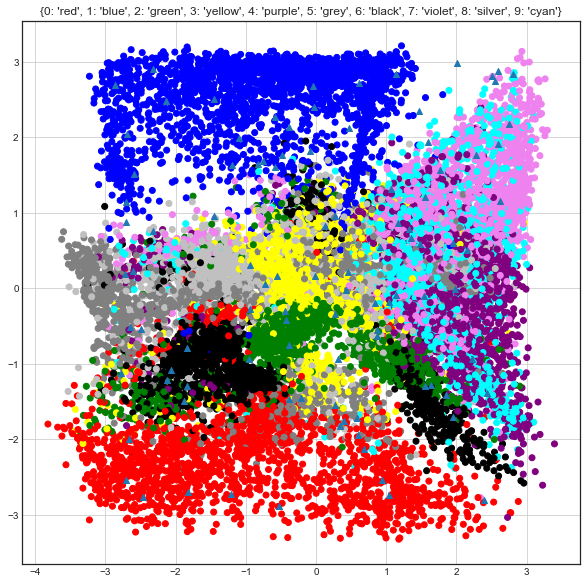

 iter: 86 batch: 19900 recon cost: 0.16308658 zero cost: 0.65286577								 one  cost: 0.68979126 fake cost: 0.90933305

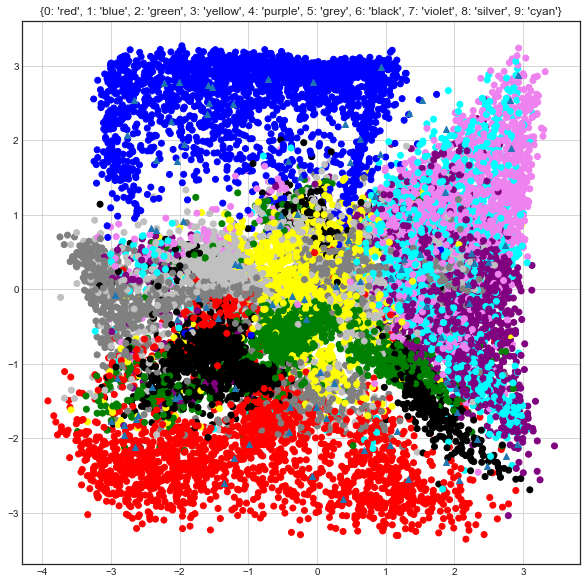

 iter: 87 batch: 19900 recon cost: 0.1630664 zero cost: 0.72966886								 one  cost: 0.6462569 fake cost: 0.8145916566

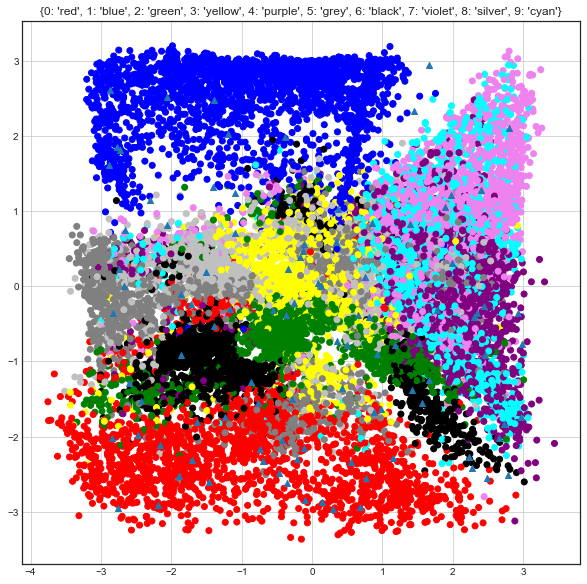

 iter: 88 batch: 19900 recon cost: 0.16268508 zero cost: 0.7088043								 one  cost: 0.7006457 fake cost: 0.8347598354

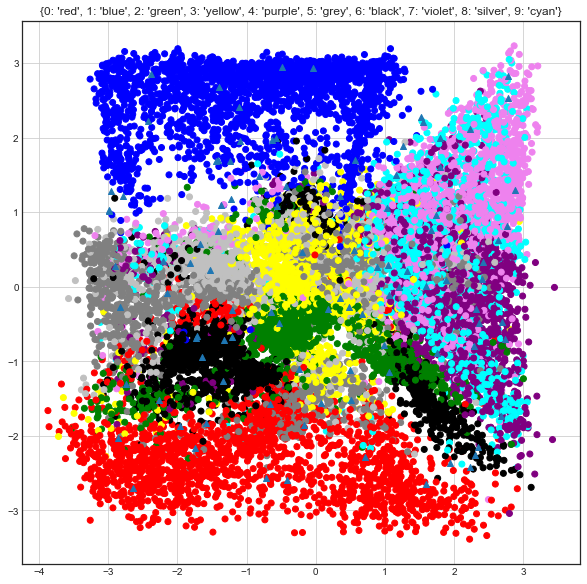

 iter: 89 batch: 19900 recon cost: 0.16251586 zero cost: 0.6772309								 one  cost: 0.66855425 fake cost: 0.863403654

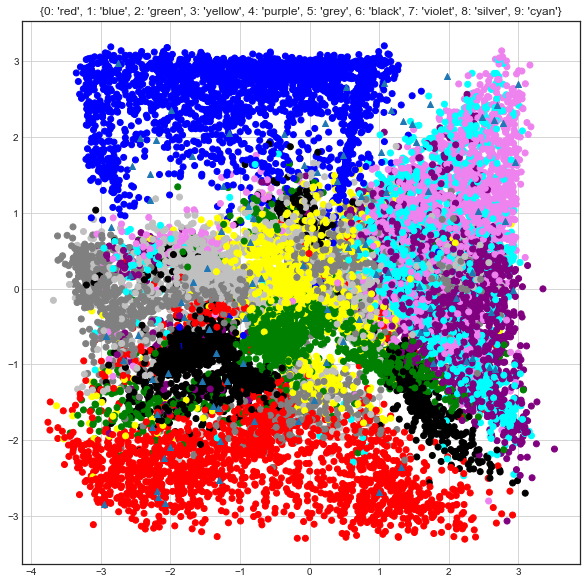

 iter: 90 batch: 19900 recon cost: 0.16239437 zero cost: 0.65744966								 one  cost: 0.6911175 fake cost: 0.879714134

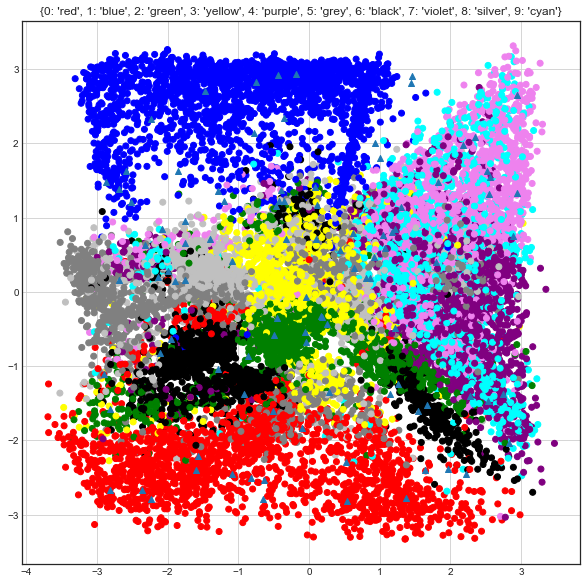

 iter: 91 batch: 19900 recon cost: 0.16217639 zero cost: 0.68996215								 one  cost: 0.62756306 fake cost: 0.84821534

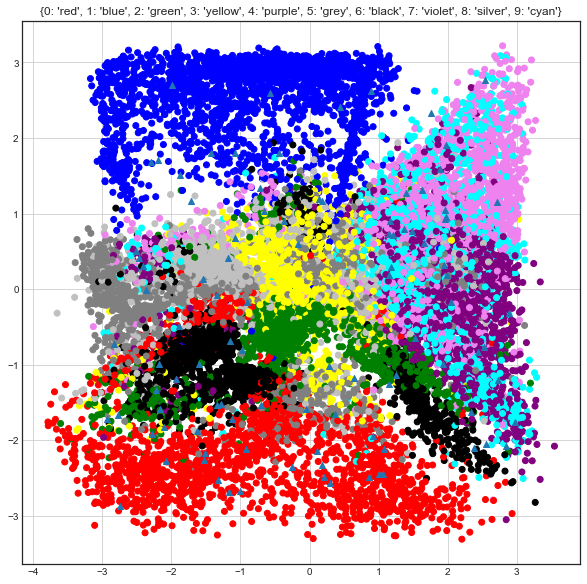

 iter: 92 batch: 19900 recon cost: 0.16212563 zero cost: 0.6731455								 one  cost: 0.56907594 fake cost: 0.866118666

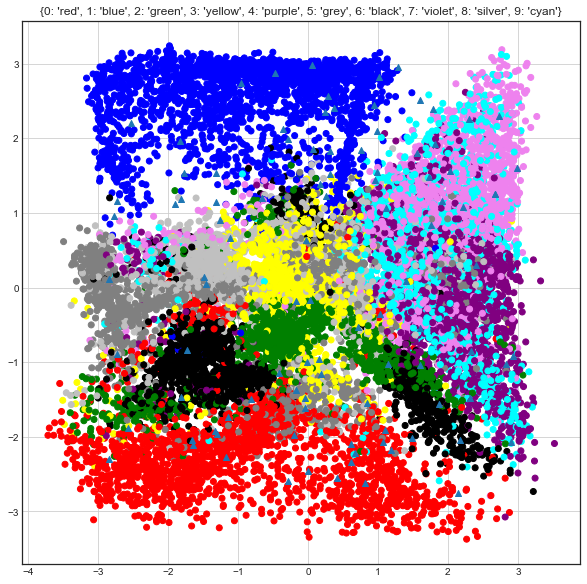

 iter: 93 batch: 19900 recon cost: 0.16198932 zero cost: 0.6551252								 one  cost: 0.6566314 fake cost: 0.8769572455

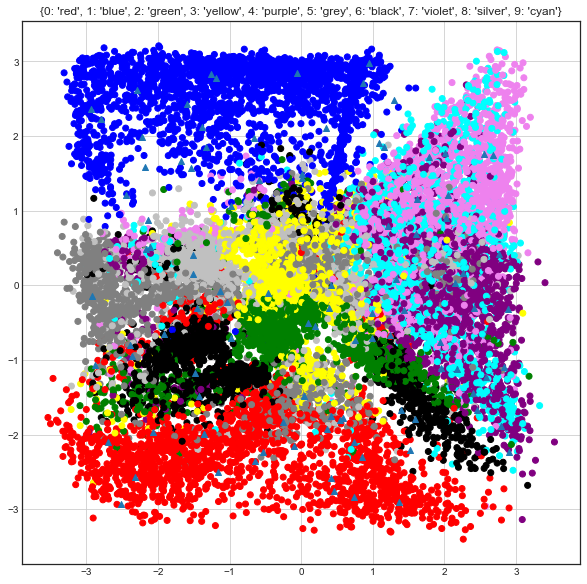

 iter: 94 batch: 19900 recon cost: 0.16189511 zero cost: 0.6880058								 one  cost: 0.63556385 fake cost: 0.847741976

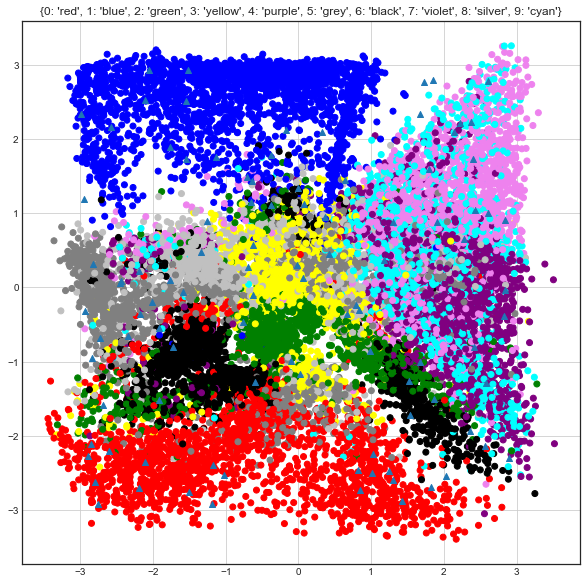

 iter: 95 batch: 19900 recon cost: 0.16182694 zero cost: 0.71723443								 one  cost: 0.60067946 fake cost: 0.81622345

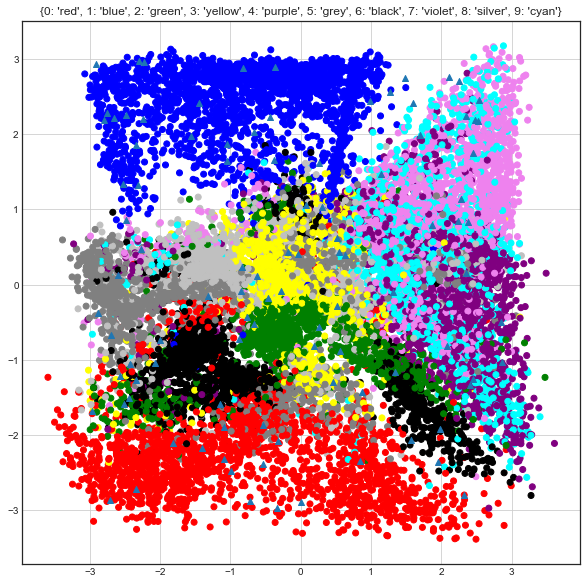

 iter: 96 batch: 19900 recon cost: 0.16161409 zero cost: 0.67594254								 one  cost: 0.620829 fake cost: 0.8587767446

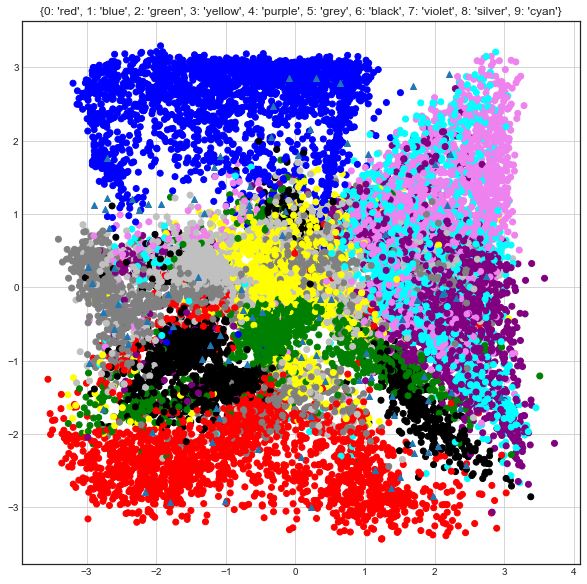

 iter: 97 batch: 19900 recon cost: 0.16143313 zero cost: 0.693384								 one  cost: 0.5989544 fake cost: 0.83717537264

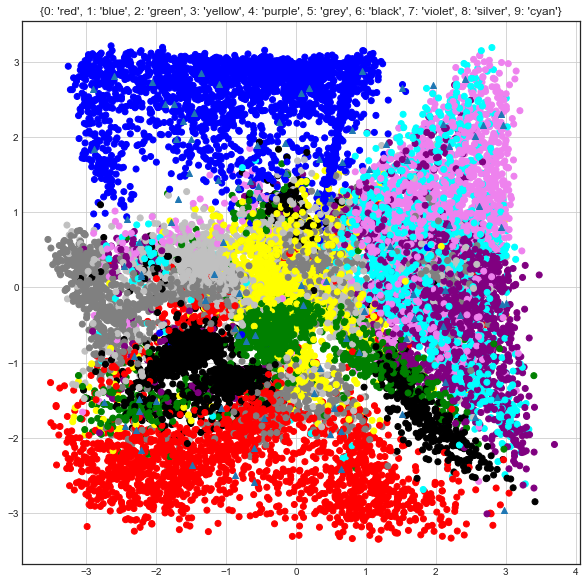

 iter: 98 batch: 19900 recon cost: 0.16136178 zero cost: 0.67113626								 one  cost: 0.71045065 fake cost: 0.84630424

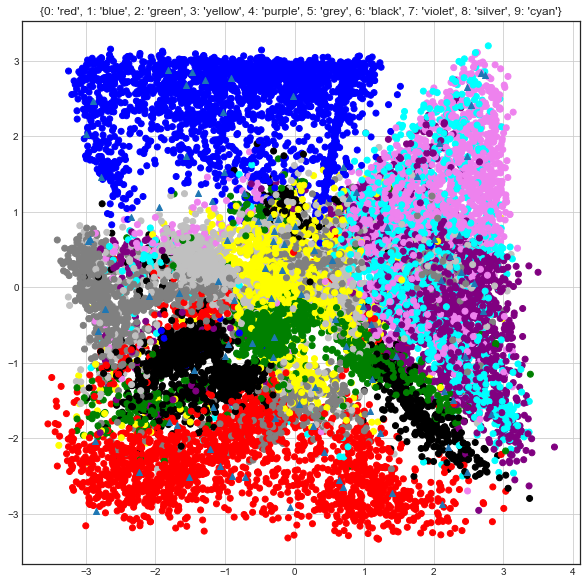

 iter: 99 batch: 19900 recon cost: 0.16128522 zero cost: 0.6791745								 one  cost: 0.58138305 fake cost: 0.855150844

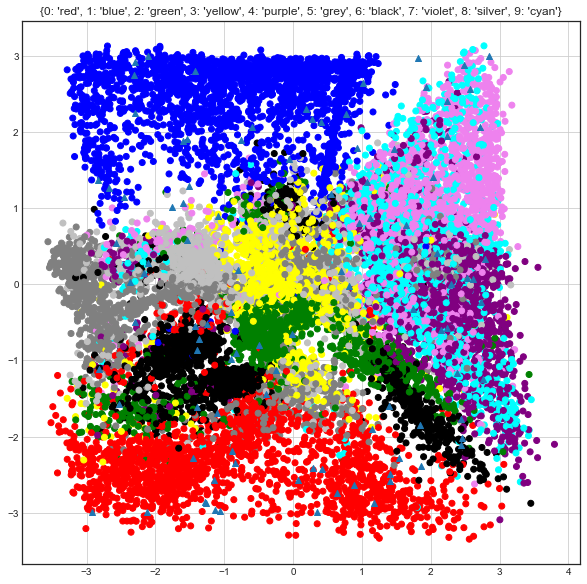

 iter: 100 batch: 19900 recon cost: 0.16099513 zero cost: 0.69800645								 one  cost: 0.6235418 fake cost: 0.832314167

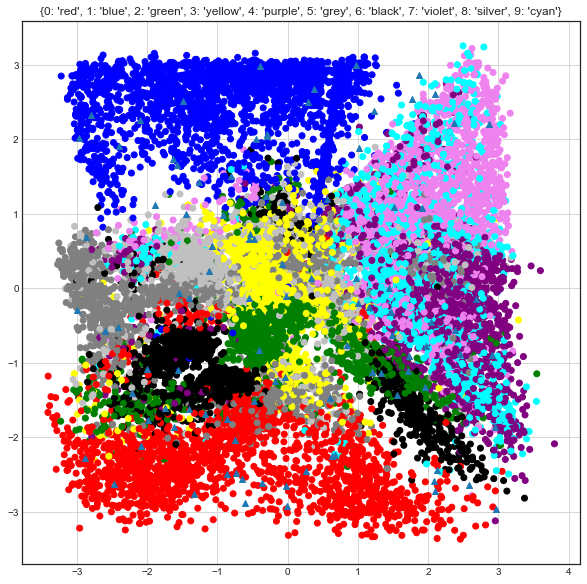

In [11]:
# start the session
try:
    sess.run(tf.global_variables_initializer())
except:
    sess = tf.InteractiveSession()
sess.run(tf.global_variables_initializer())
train_batch_shuffled = train_batch.copy()
color_dict = {0:'red',1:'blue',2:'green',3:'yellow',4:'purple',5:'grey',6:'black',7:'violet',8:'silver',9:'cyan'}

for iter in range(num_epoch):
    for current_data_index in range(0,len(train_batch),batch_size):
        prior_z      = np.random.uniform(low=-3.0, high=3.0,size=(batch_size, 2)).astype(np.float32)
        current_data = train_batch_shuffled[current_data_index:current_data_index+batch_size].astype(np.float32)
    
        sess_result0 = sess.run([recon_cost,grad0_update],
        feed_dict={x0:current_data.reshape((batch_size,-1)),lr0:0.0002
        })

        sess_result1 = sess.run([dis_cost1,grad1_update],
        feed_dict={x1:current_data.reshape((batch_size,-1)),lr1:0.001})

        sess_result2 = sess.run([dis_cost2,grad2_update],
        feed_dict={x2:prior_z                              ,lr2:0.001})
        
        sess_result3 = sess.run([fake_cost,fake_grad_update],
        feed_dict={x3:current_data.reshape((batch_size,-1)),lr3:0.002})

        sys.stdout.write('\r iter: ' + str(iter) + ' batch: ' + str(current_data_index) + \
            ' recon cost: ' + str(sess_result0[0]) + \
            ' zero cost: ' + str(sess_result1[0]) + '\t\t\t\t\t\t\t\t' + \
            ' one  cost: ' + str(sess_result2[0]) + \
            ' fake cost: ' + str(sess_result3[0]) 
        ); sys.stdout.flush()
        
        
    if iter % print_size == 0:
        random_idx = np.random.permutation(len(train_batch_shuffled))
        temp_data  = train_batch_shuffled[random_idx][:batch_size].reshape((batch_size,-1))
#         sess_result = sess.run(dlayer3,
#                       feed_dict={x0:temp_data }).reshape((batch_size,28,28))
#         fig=plt.figure(figsize=(15, 15)); columns = 10 ; rows = 1
#         for i in range(1, columns*rows +1):
#             fig.add_subplot(rows, columns, i)
#             if i % 2 ==0 :
#                   plt.imshow(np.squeeze(sess_result[i-2]),cmap='gray')
#             else:
#                 plt.imshow(np.squeeze(temp_data[i-1]).reshape((28,28)),cmap='gray')
#             plt.axis('off')
#         plt.show()
        
        # Show the latent space        
        all_latent_vectors = sess.run(elayer33,feed_dict={x3:train_batch[:batch_size].reshape((batch_size,-1))})
        for current_batch_index in range(batch_size,len(train_batch), batch_size):
            current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
            sess_results = sess.run(elayer33,feed_dict={x3:current_train_data.reshape((batch_size,-1))})
            all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
        fig = plt.figure(figsize=(10,10))
        color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
        plt.title(str(color_dict))
        plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
        plt.scatter(prior_z[:,0],prior_z[:,1],marker='^')
#         plt.xlim(-15,15);plt.ylim(-15,15);
        plt.grid();plt.show()

In [12]:
# convert every data into latent to know the statistics
all_latent_vectors = sess.run(elayer3,feed_dict={x:train_batch[:batch_size].reshape((batch_size,-1))})
print(train_batch.shape)
print(all_latent_vectors.shape)
for current_batch_index in range(batch_size,len(train_batch), batch_size):
    current_train_data = train_batch[current_batch_index:current_batch_index+batch_size]
    sess_results = sess.run(elayer3,feed_dict={x:current_train_data.reshape((batch_size,-1))})
    all_latent_vectors = np.vstack((all_latent_vectors,sess_results))
print(all_latent_vectors.shape)

NameError: name 'x' is not defined

In [ ]:
# view the latent vectors
fig = plt.figure(figsize=(10,10))
color_dict = {
    0:'red',
    1:'blue',
    2:'green',
    3:'yellow',
    4:'purple',
    5:'grey',
    6:'black',
    7:'violet',
    8:'silver',
    9:'cyan',
}
color_mapping = [color_dict[x] for x in np.argmax(train_label[:len(train_batch),:],1) ]
plt.title(str(color_dict))
plt.scatter(all_latent_vectors[:,0],all_latent_vectors[:,1],c=color_mapping)
plt.grid()
plt.show()